# Exploratory data Analysis with Customer Segmentation - Clustering + Classification

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns

from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import scipy.stats as stats
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AffinityPropagation
from sklearn.decomposition import PCA
import warnings
import dabl
import missingno as msno
import plotly.express as px

%matplotlib inline

from autoviz.AutoViz_Class import AutoViz_Class
warnings.filterwarnings("ignore")

Imported AutoViz_Class version: 0.0.68. Call using: 
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
            
To remove previous versions, perform 'pip uninstall autoviz'


### Loading Training and Test Datasets


In [3]:
df = pd.read_csv('../data/telecom/cell2celltrain.csv')
df_h = pd.read_csv('../data/telecom/cell2cellholdout.csv')

In [4]:
df.head(5)

,CustomerID,Churn,MonthlyRevenue,MonthlyMinutes,TotalRecurringCharge,DirectorAssistedCalls,OverageMinutes,RoamingCalls,PercChangeMinutes,PercChangeRevenues,...,ReferralsMadeBySubscriber,IncomeGroup,OwnsMotorcycle,AdjustmentsToCreditRating,HandsetPrice,MadeCallToRetentionTeam,CreditRating,PrizmCode,Occupation,MaritalStatus
0,3000002,Yes,24.00,219.0,22.0,0.25,0.0,0.0,-157.0,-19.0,...,0,4,No,0,30,Yes,1-Highest,Suburban,Professional,No
1,3000010,Yes,16.99,10.0,17.0,0.00,0.0,0.0,-4.0,0.0,...,0,5,No,0,30,No,4-Medium,Suburban,Professional,Yes
2,3000014,No,38.00,8.0,38.0,0.00,0.0,0.0,-2.0,0.0,...,0,6,No,0,Unknown,No,3-Good,Town,Crafts,Yes
3,3000022,No,82.28,1312.0,75.0,1.24,0.0,0.0,157.0,8.1,...,0,6,No,0,10,No,4-Medium,Other,Other,No
4,3000026,Yes,17.14,0.0,17.0,0.00,0.0,0.0,0.0,-0.2,...,0,9,No,1,10,No,1-Highest,Other,Professional,Yes


##### Analysis of Missing Values in Columns

In [5]:
print("Missing values in each column:\n{}".format(df.isnull().sum()))
print("Columns data types:\n{}".format(df.dtypes))

Missing values in each column:
CustomerID                     0
Churn                          0
MonthlyRevenue               156
MonthlyMinutes               156
TotalRecurringCharge         156
DirectorAssistedCalls        156
OverageMinutes               156
RoamingCalls                 156
PercChangeMinutes            367
PercChangeRevenues           367
DroppedCalls                   0
BlockedCalls                   0
UnansweredCalls                0
CustomerCareCalls              0
ThreewayCalls                  0
ReceivedCalls                  0
OutboundCalls                  0
InboundCalls                   0
PeakCallsInOut                 0
OffPeakCallsInOut              0
DroppedBlockedCalls            0
CallForwardingCalls            0
CallWaitingCalls               0
MonthsInService                0
UniqueSubs                     0
ActiveSubs                     0
ServiceArea                   24
Handsets                       1
HandsetModels                  1
CurrentEquip

##### Analysis of Unique Values in Columns

In [6]:
n_unique = df.nunique()
print("Number of unique values:\n{}".format(n_unique))

Number of unique values:
CustomerID                   51047
Churn                            2
MonthlyRevenue               12665
MonthlyMinutes                2719
TotalRecurringCharge           214
DirectorAssistedCalls          146
OverageMinutes                 746
RoamingCalls                   530
PercChangeMinutes             2262
PercChangeRevenues            2899
DroppedCalls                   285
BlockedCalls                   373
UnansweredCalls                840
CustomerCareCalls              185
ThreewayCalls                   78
ReceivedCalls                 6121
OutboundCalls                  787
InboundCalls                   472
PeakCallsInOut                1839
OffPeakCallsInOut             1669
DroppedBlockedCalls            447
CallForwardingCalls             31
CallWaitingCalls               223
MonthsInService                 56
UniqueSubs                      15
ActiveSubs                      12
ServiceArea                    747
Handsets                      

In [7]:
print("Unique values in each categorical column:")
for col in df.select_dtypes(include=[object]):
    if(col != 'ServiceArea'):
         print(col,":", df[col].unique())

Unique values in each categorical column:
Churn : ['Yes' 'No']
ChildrenInHH : ['No' 'Yes']
HandsetRefurbished : ['No' 'Yes']
HandsetWebCapable : ['Yes' 'No']
TruckOwner : ['No' 'Yes']
RVOwner : ['No' 'Yes']
Homeownership : ['Known' 'Unknown']
BuysViaMailOrder : ['Yes' 'No']
RespondsToMailOffers : ['Yes' 'No']
OptOutMailings : ['No' 'Yes']
NonUSTravel : ['No' 'Yes']
OwnsComputer : ['Yes' 'No']
HasCreditCard : ['Yes' 'No']
NewCellphoneUser : ['No' 'Yes']
NotNewCellphoneUser : ['No' 'Yes']
OwnsMotorcycle : ['No' 'Yes']
HandsetPrice : ['30' 'Unknown' '10' '80' '150' '300' '40' '200' '100' '130' '60' '400'
 '240' '250' '180' '500']
MadeCallToRetentionTeam : ['Yes' 'No']
CreditRating : ['1-Highest' '4-Medium' '3-Good' '6-VeryLow' '2-High' '5-Low' '7-Lowest']
PrizmCode : ['Suburban' 'Town' 'Other' 'Rural']
Occupation : ['Professional' 'Crafts' 'Other' 'Self' 'Retired' 'Homemaker' 'Clerical'
 'Student']
MaritalStatus : ['No' 'Yes' 'Unknown']


In [16]:
df.columns

Index(['CustomerID', 'Churn', 'MonthlyRevenue', 'MonthlyMinutes',
       'TotalRecurringCharge', 'DirectorAssistedCalls', 'OverageMinutes',
       'RoamingCalls', 'PercChangeMinutes', 'PercChangeRevenues',
       'DroppedCalls', 'BlockedCalls', 'UnansweredCalls', 'CustomerCareCalls',
       'ThreewayCalls', 'ReceivedCalls', 'OutboundCalls', 'InboundCalls',
       'PeakCallsInOut', 'OffPeakCallsInOut', 'DroppedBlockedCalls',
       'CallForwardingCalls', 'CallWaitingCalls', 'MonthsInService',
       'UniqueSubs', 'ActiveSubs', 'ServiceArea', 'Handsets', 'HandsetModels',
       'CurrentEquipmentDays', 'AgeHH1', 'AgeHH2', 'ChildrenInHH',
       'HandsetRefurbished', 'HandsetWebCapable', 'TruckOwner', 'RVOwner',
       'Homeownership', 'BuysViaMailOrder', 'RespondsToMailOffers',
       'OptOutMailings', 'NonUSTravel', 'OwnsComputer', 'HasCreditCard',
       'RetentionCalls', 'RetentionOffersAccepted', 'NewCellphoneUser',
       'NotNewCellphoneUser', 'ReferralsMadeBySubscriber', 'IncomeGro

In [23]:
len(df.columns)

58

Splitting the columns into 2 halves to represent missing values and their corresponding col names

In [26]:
dfx1= df[df.columns[0:28]]
dfx2= df[df.columns[28:]]

##### Usinh msno library to visualize missing values for each column

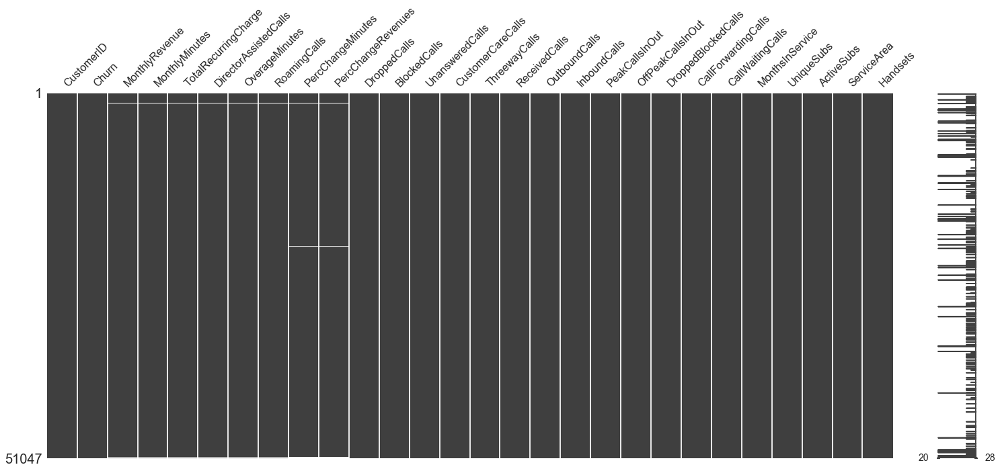

In [27]:
msno.matrix(dfx1)

The above figure illustartes there are missing values for features MonthlyRevenue, MonthlyMinutes, TotalRecurringCharge,...PerChangeRevenues

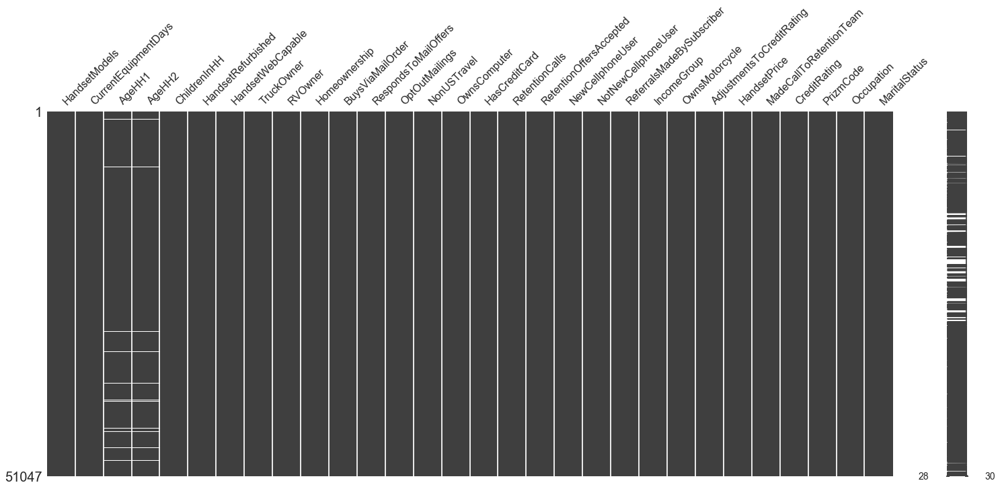

In [28]:
msno.matrix(dfx2)

The above figure illustartes there are missing values for features AgeHH1 and AgeHH2

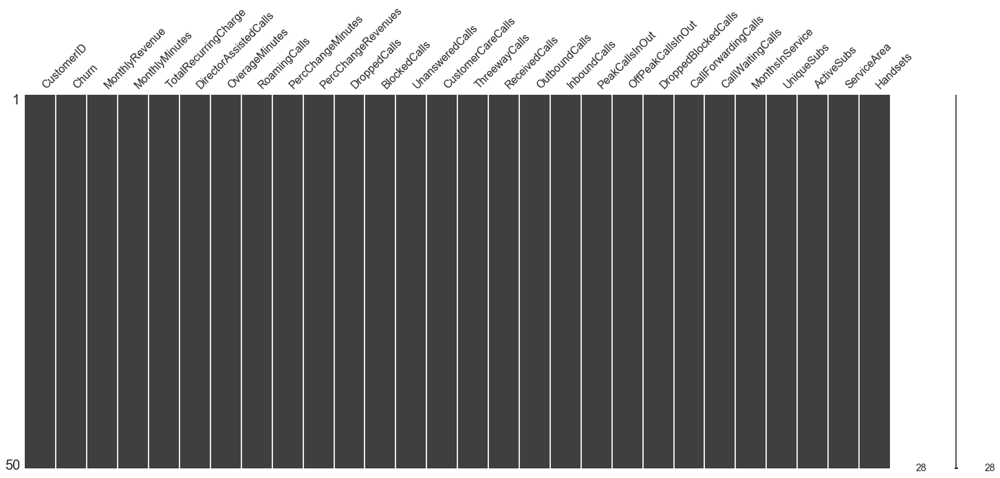

In [29]:
msno.matrix(dfx1.sample(50))

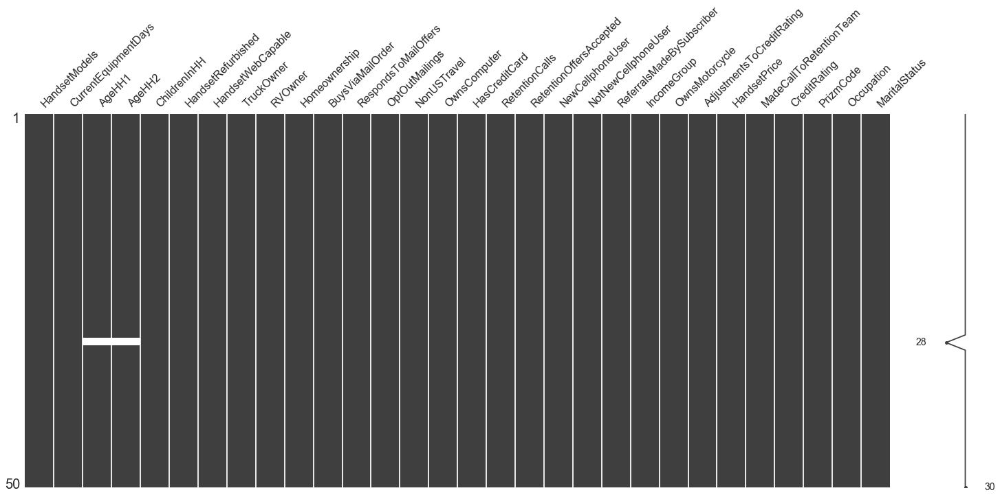

In [30]:
msno.matrix(dfx2.sample(50))

# Bar chart to depict Missing values

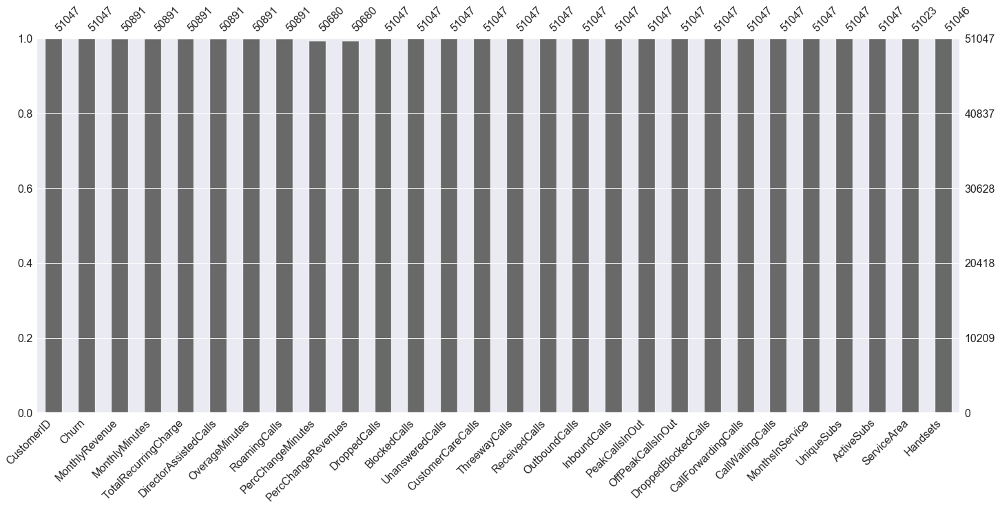

In [32]:
msno.bar(dfx1)

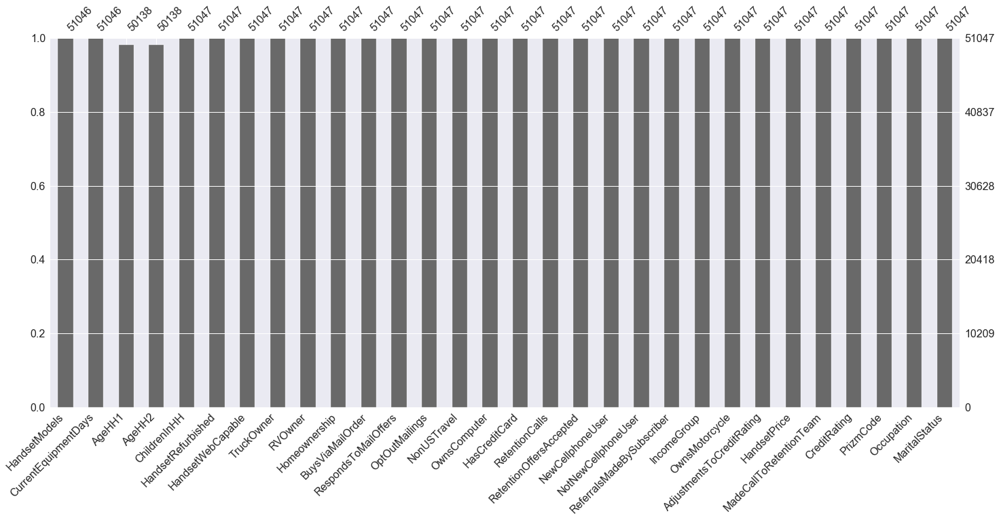

In [33]:
msno.bar(dfx2)

The above 2 figures gives a visual representation of the actual number of values present for each feature.

# HeatMap

missingno.heatmap measures nullity correlation: how strongly the presence or absence of one variable affects the presence of another:

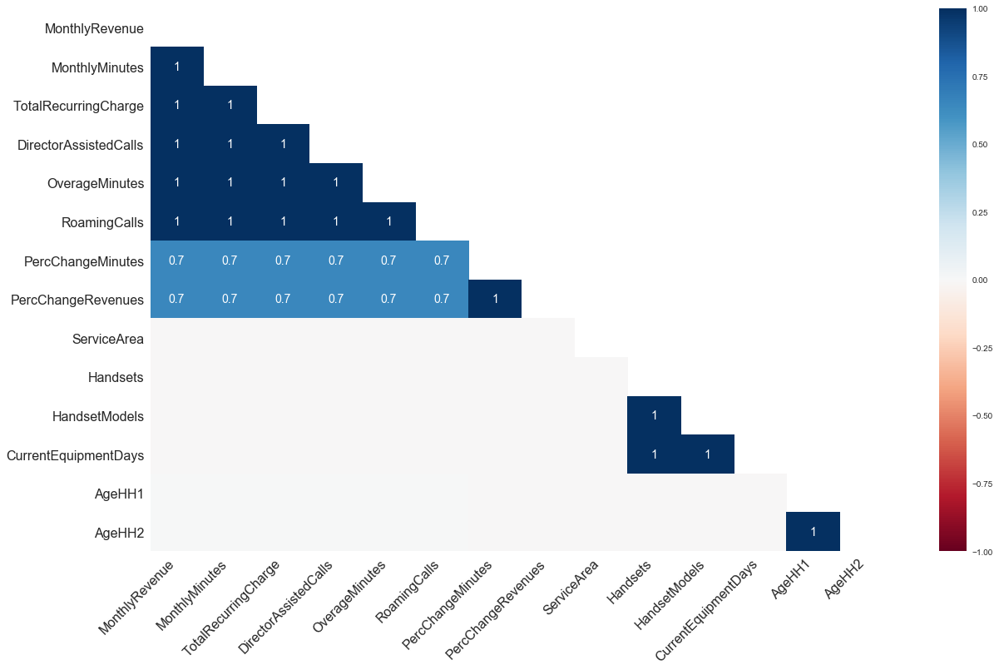

In [34]:
msno.heatmap(df)


# Bamboolib

In [35]:
import bamboolib as bam
bam.enable()

Success: the bamboolib extension was enabled successfully. You can disable it via 'bam.disable()'. You will now see a magic bamboolib button when you display your dataframes, for example via 'df'


We installed Bamboolib, after that the software support told they will get back with license. With this open source library we can have an interactive UI to browse through the input features.

# EDA with dabl

dabl provides a high-level interface that summarizes several common high-level plots. For low dimensional datasets, all features are shown; for high dimensional datasets, only the most informative features for the given task are shown

Target looks like classification
Showing only top 10 of 31 continuous features
Linear Discriminant Analysis training set score: 0.501


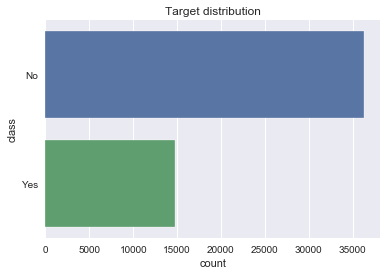

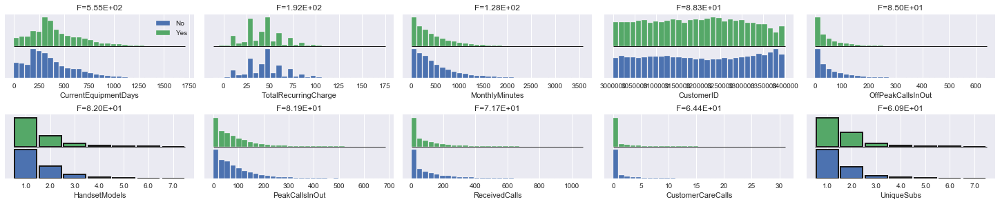

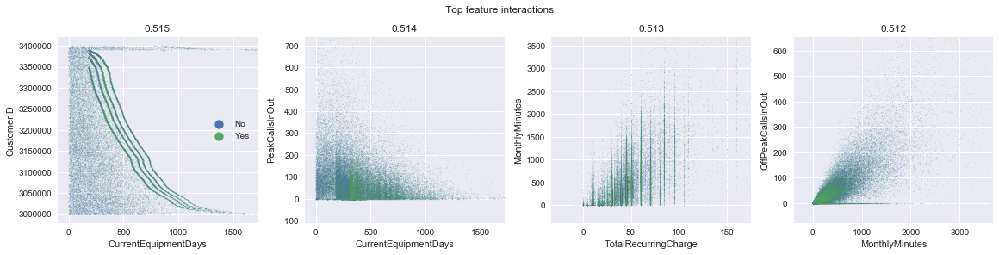

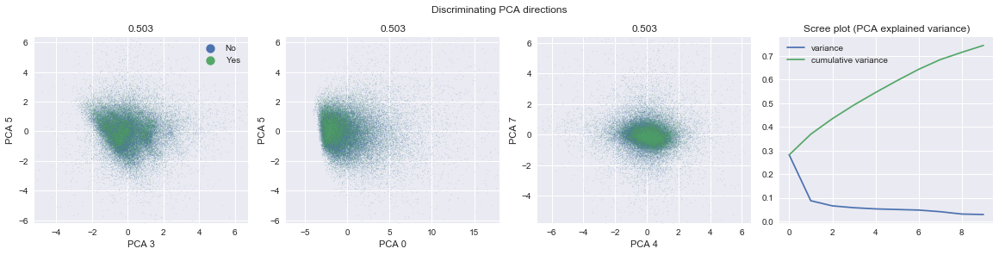

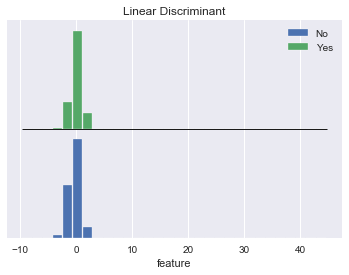

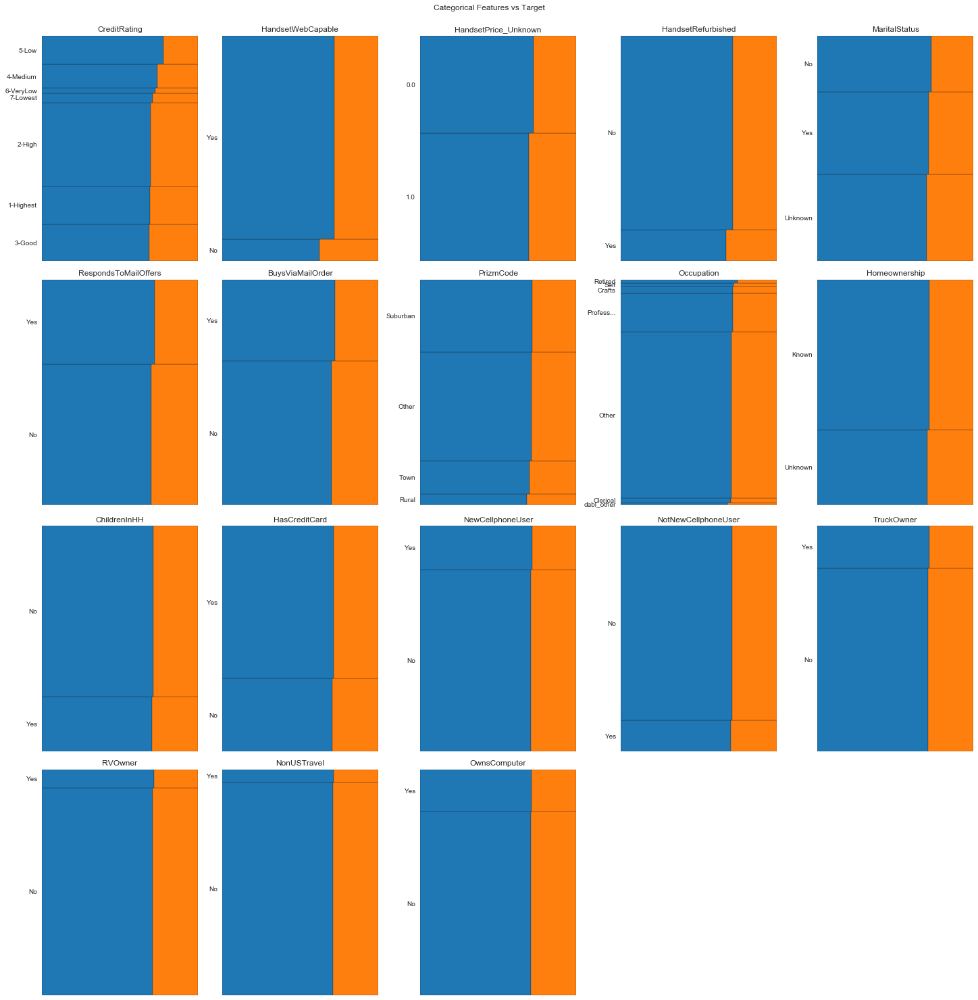

In [41]:
dabl.plot(dfx, target_col="Churn", verbose=10)

The first dabl plot displays frequency distribution of CurrentEquipmentDays, TotalRecurringCharge, MonthlyMinutes, CustomerID, OnPeakCaallsIn, HandsetModels , PeakCalllsInOut, ReceivedCalls, CustomerCareCallls, UniqueSubs for Customers who have Churned as well who have not. We don't see any noticeble difference between them

The 2nd type of dabl plot displays top feature interaactions between Curned aand non-Churned customers, where also we dont find any noticeble difference between Churned and Non-Churned customers.

The 3rd type of dabl plot displays different pricipal components of these 2 output categories, without showing any noticeble differences.

# EDA with AutoViz

In [38]:
AV = AutoViz_Class()

In [39]:
datapath = '../data/telecom/'
filename = 'cell2celltrain.csv'
sep = ','
target = 'Churn'

Shape of your Data Set: (51047, 58)
Classifying variables in data set...
    57 Predictors classified...
        This does not include the Target column(s)
    2 variables removed since they were ID or low-information variables
Since Number of Rows in data 51047 exceeds maximum, randomly sampling 1500 rows for EDA...
Total Number of Scatter Plots = 231
Number of Cat and Continuous Vars exceeds 30, hence no Pivot or Bar Charts
Time to run AutoViz (in seconds) = 26.398


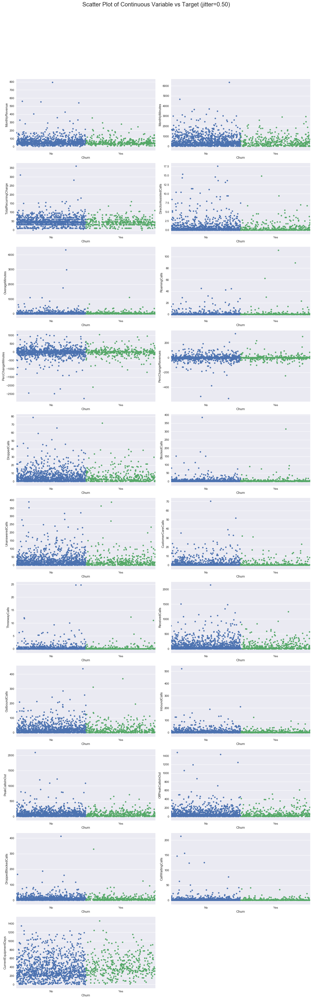

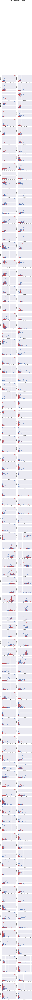

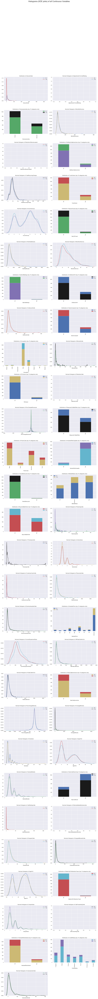

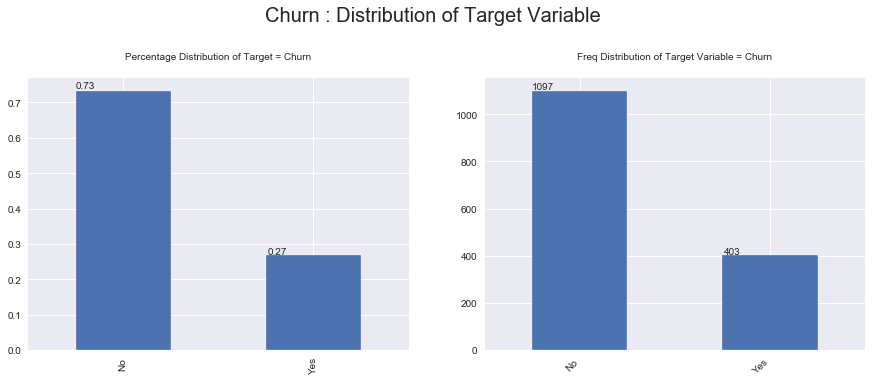

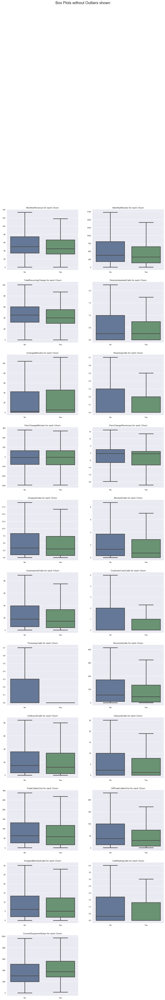

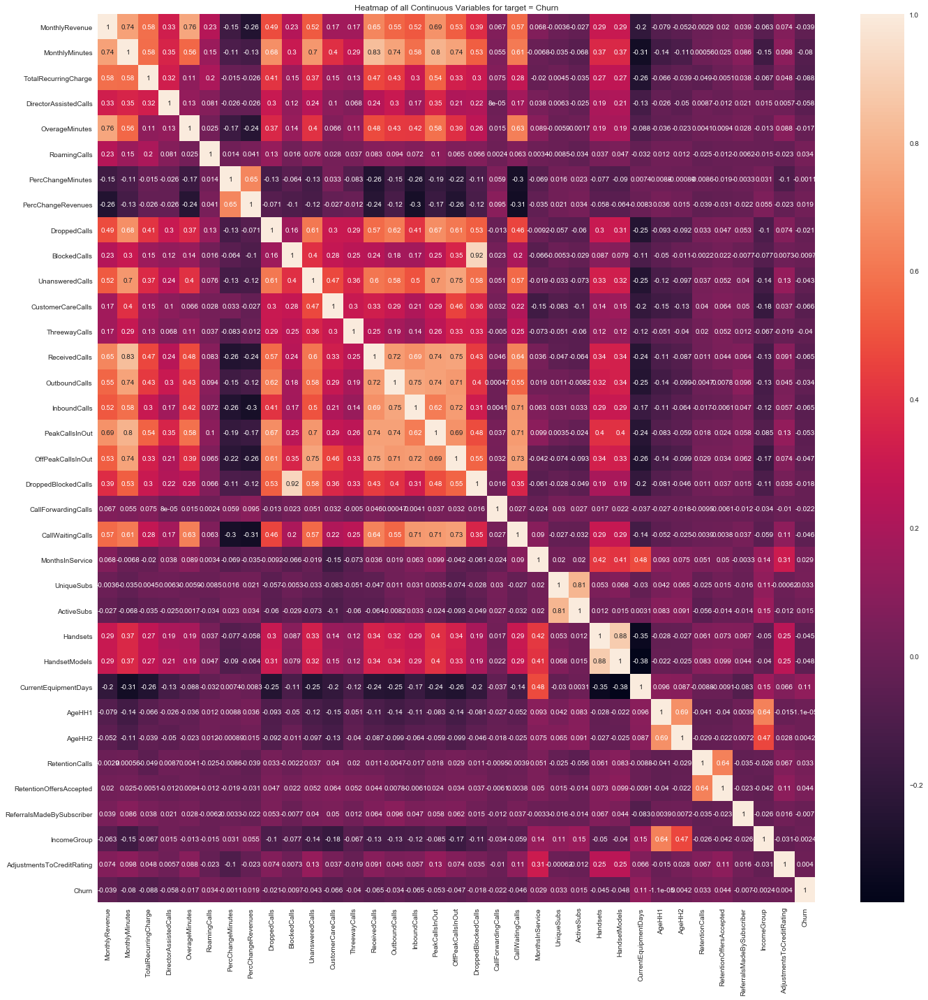

In [40]:
dft = AV.AutoViz('../data/telecom/cell2celltrain.csv', sep=sep, depVar=target, dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=1500,max_cols_analyzed=30)

The first type of Plot with AutoViz is Feature Interaction Plot showing how one feature changes with another for Churned as well as non-Churned customers, for continious features.


The second type of Plot with AutoViz is Feature Interaction Plot showing how one feature changes with another for Churned as well as non-Churned customers, for Caategorical features.

Both kind of plots resemble closely for 2 categories (churned and non-churned) except that the proportion of Non-Churned customers are high.

# EDA with ScallterPlots, BoxPlots

Next I continue analysis with different Scatter and BoxPlots. We make few observations as :

In general , customers from Income Group 0 and 6 are higher than other Income Groups. Similarly occupation wise "Professional" and "Other" are considerably higher, and so is who have MaritalStatus = "No".

In [51]:
def scatters(data, h=None, pal=None):
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5,1, figsize=(14,10))
    sns.scatterplot(x="IncomeGroup",y="Handsets", hue=h, palette=pal, data=data, ax=ax1)
    sns.scatterplot(x="Occupation",y="Handsets", hue=h, palette=pal, data=data, ax=ax2)
    sns.scatterplot(x="MaritalStatus",y="Handsets", hue=h, palette=pal, data=data, ax=ax3)
    sns.scatterplot(x="MonthlyMinutes",y="Handsets", hue=h, palette=pal, data=data, ax=ax4)
    sns.scatterplot(x="MonthlyRevenue",y="Handsets", hue=h, palette=pal, data=data, ax=ax5)
    plt.tight_layout()

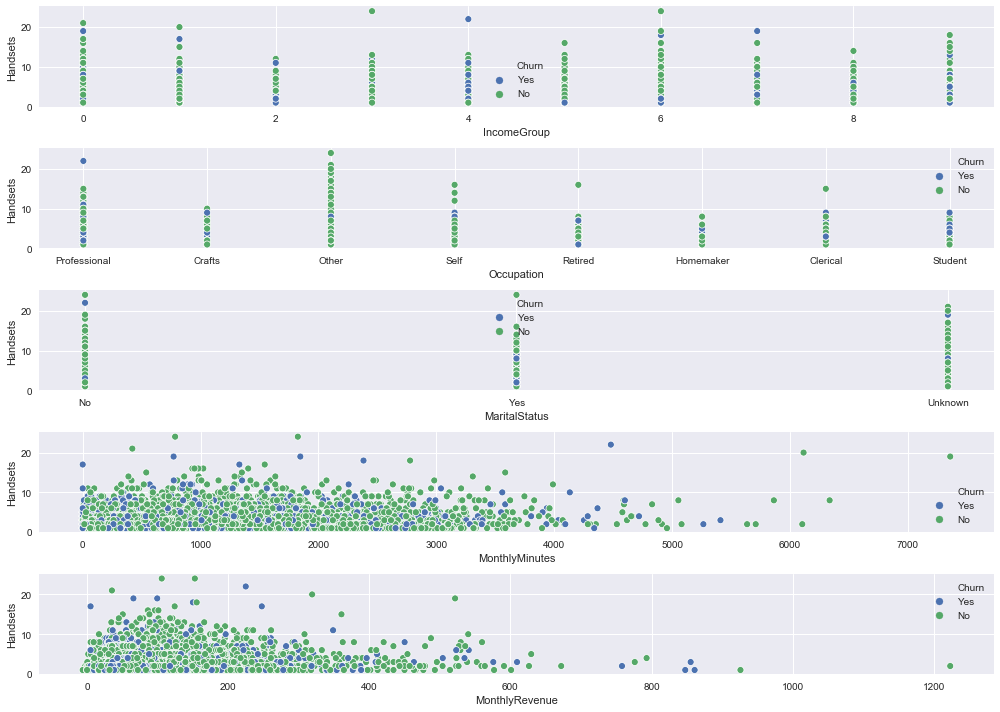

In [52]:
scatters(df, h="Churn")

In [53]:
df.columns

Index(['CustomerID', 'Churn', 'MonthlyRevenue', 'MonthlyMinutes',
       'TotalRecurringCharge', 'DirectorAssistedCalls', 'OverageMinutes',
       'RoamingCalls', 'PercChangeMinutes', 'PercChangeRevenues',
       'DroppedCalls', 'BlockedCalls', 'UnansweredCalls', 'CustomerCareCalls',
       'ThreewayCalls', 'ReceivedCalls', 'OutboundCalls', 'InboundCalls',
       'PeakCallsInOut', 'OffPeakCallsInOut', 'DroppedBlockedCalls',
       'CallForwardingCalls', 'CallWaitingCalls', 'MonthsInService',
       'UniqueSubs', 'ActiveSubs', 'ServiceArea', 'Handsets', 'HandsetModels',
       'CurrentEquipmentDays', 'AgeHH1', 'AgeHH2', 'ChildrenInHH',
       'HandsetRefurbished', 'HandsetWebCapable', 'TruckOwner', 'RVOwner',
       'Homeownership', 'BuysViaMailOrder', 'RespondsToMailOffers',
       'OptOutMailings', 'NonUSTravel', 'OwnsComputer', 'HasCreditCard',
       'RetentionCalls', 'RetentionOffersAccepted', 'NewCellphoneUser',
       'NotNewCellphoneUser', 'ReferralsMadeBySubscriber', 'IncomeGro

# Linear correlation between MonthlyRevenue and OutboundCalls

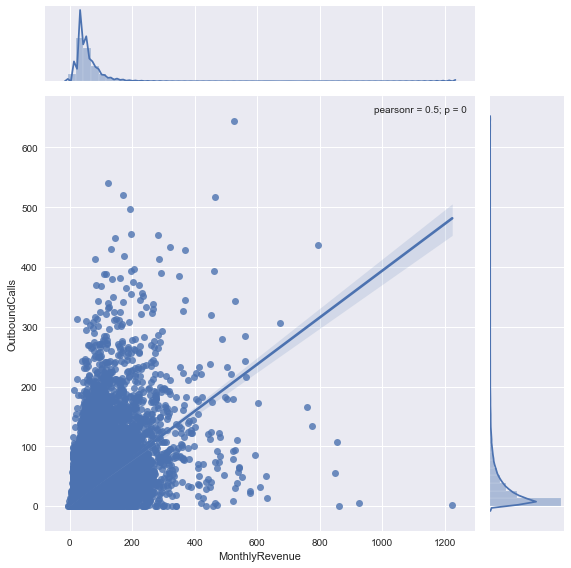

In [61]:
r1 = sns.jointplot(x="MonthlyRevenue",y="OutboundCalls", data=df, kind="reg", height=8)
r1.annotate(stats.pearsonr)
plt.show()

The plot above shows a linear correlation with Pearson value of 0.5 and negligible p-value. That make’s sense because usually, outboundcalls are related to MonthlyRevenue. Below I will analyse linear regression plots with various categorisations.

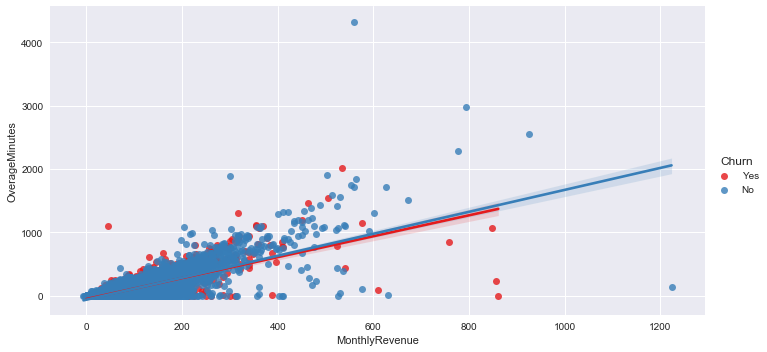

In [62]:
sns.lmplot(x="MonthlyRevenue",y="OverageMinutes", hue="Churn", data=df, palette="Set1", aspect=2)
plt.show()

We also see that there is a linear relation <0.5 of OverageMinutes and MonthlyRevenue. And the relation coincides for Churned and 
Non-Churned Customers.

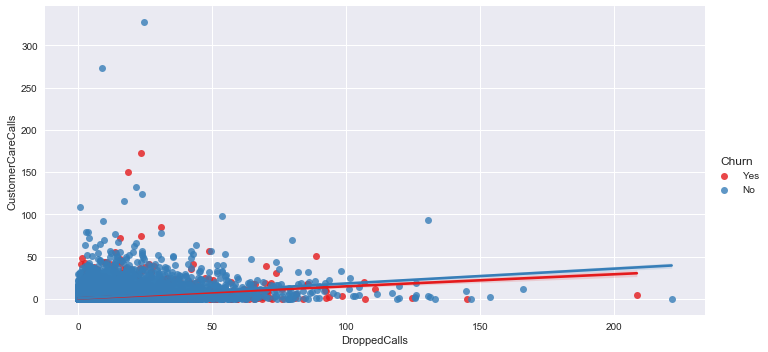

In [63]:
sns.lmplot(x="DroppedCalls",y="CustomerCareCalls", hue="Churn", data=df, palette="Set1", aspect=2)
plt.show()

There's practically low/no correlation between CustomerCareCalls and Number of DroppedCalls

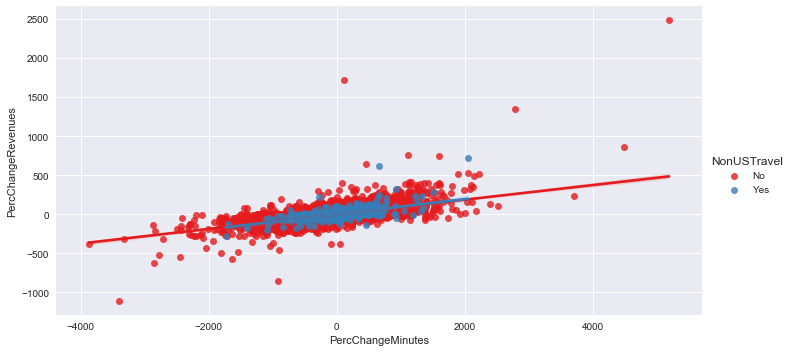

In [68]:
sns.lmplot(x="PercChangeMinutes",y="PercChangeRevenues", hue="NonUSTravel", data=df, palette="Set1", aspect=2)
plt.show()

The regression plot futher reveals PercChangeRevenues and PercChangeMinutes posseses a linear relationship

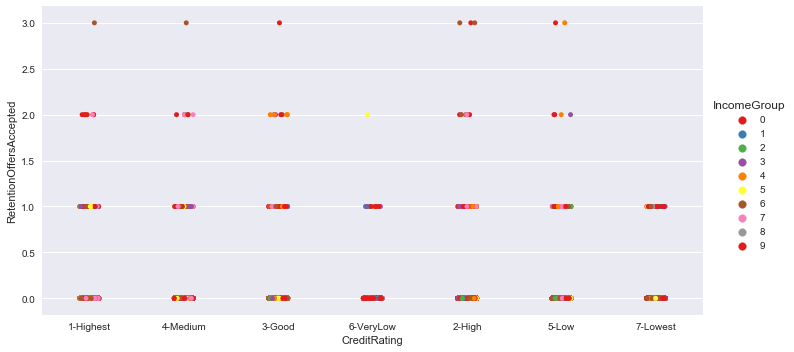

In [72]:
sns.catplot(x="CreditRating",y="RetentionOffersAccepted", hue="IncomeGroup", data=df, palette="Set1", aspect=2)
plt.show()

As we use snsplot , it reveals that all people except Lowest and Low Income Groups accept Renetention Offers

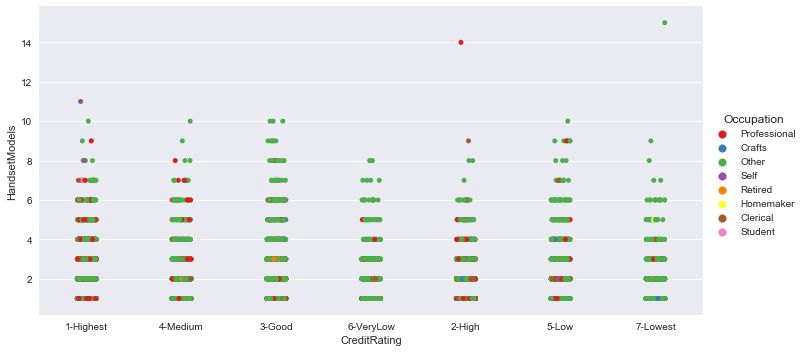

In [87]:
sns.catplot(x="CreditRating",y="HandsetModels", hue="Occupation", data=df, palette="Set1", aspect=2)
plt.show()

Prefessionals and people of other occupation are present in higher proportion in overall dataset and hence we find their presence in creditRating also.

# Box Plots to EDA between 3 features

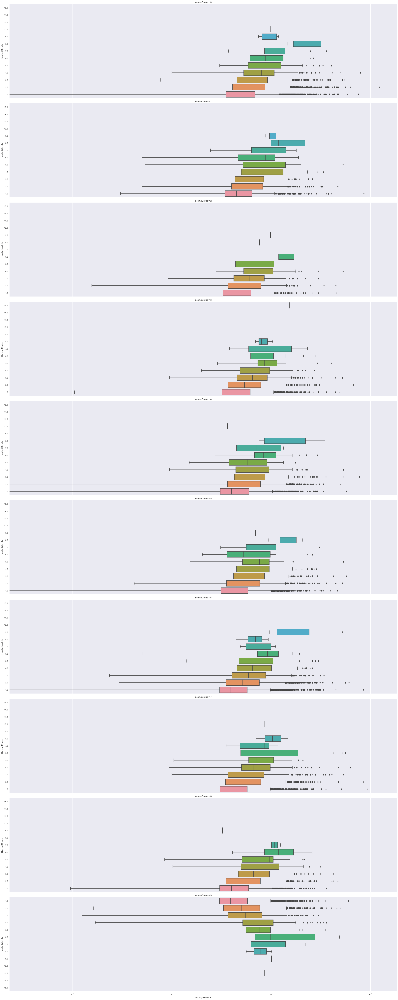

In [8]:
g = sns.catplot(x="MonthlyRevenue", y="HandsetModels", row="IncomeGroup",
                kind="box",  orient="h", height=7, aspect=4, data=df)
g.set(xscale="log");

Except IncomeGroup-9, all other Income-Groups have generic pattern of HandsetModels and MonthlyRevenue

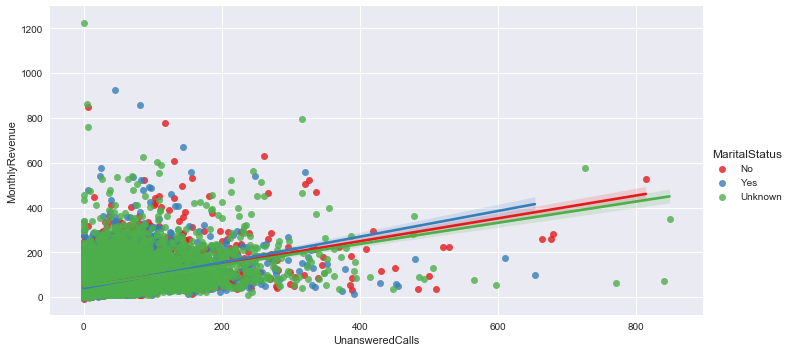

In [75]:
sns.lmplot(x="UnansweredCalls",y="MonthlyRevenue", hue="MaritalStatus", data=df, palette="Set1", aspect=2)
plt.show()

Plotting the combination of "UnansweredCalls" and “MonthlyRevenue” has a linear realationship for Marital status of people who are married , non-married vs unknown in that order.

##### JointPlots to explore the concentration of values between 2 variables

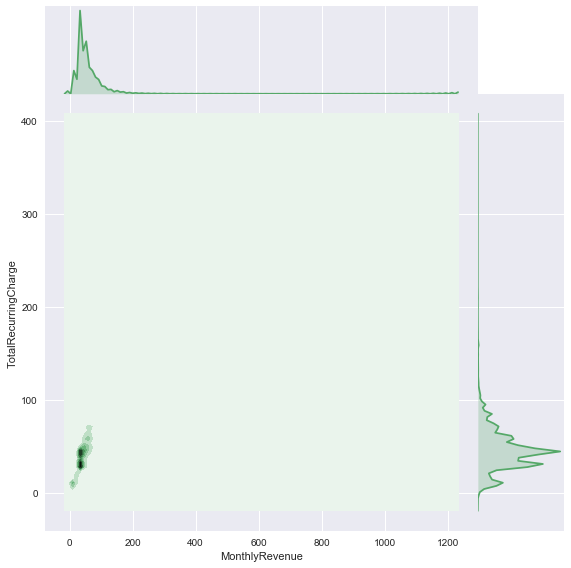

In [81]:
sns.jointplot("MonthlyRevenue","TotalRecurringCharge", data=df, kind="kde", space=0, color="g",  height=8)
plt.show()

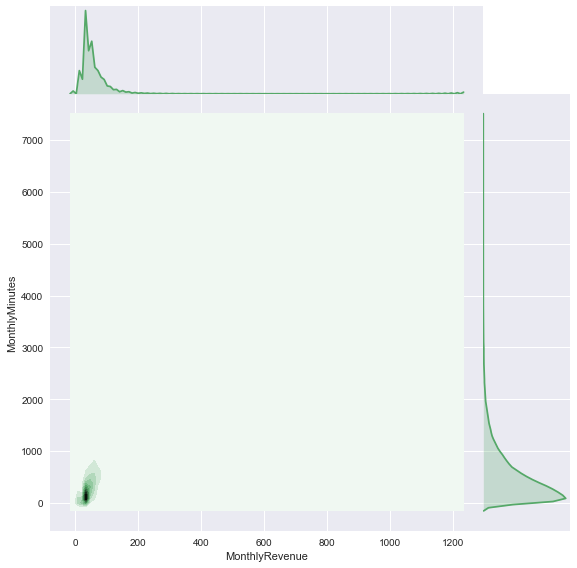

In [82]:
sns.jointplot("MonthlyRevenue","MonthlyMinutes", data=df, kind="kde", space=0, color="g",  height=8)
plt.show()

The above 2 joint plots reveal that MonthlyRevenue and MonthlyMinutes as well as TotalrecurringCharge and MonthyRevenue is left-skewed between 0-100

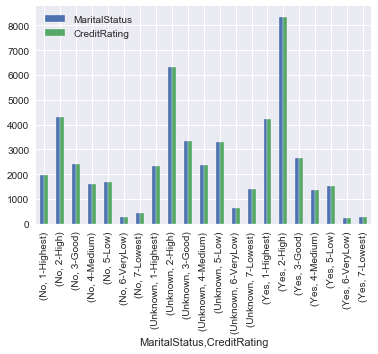

In [99]:
df.groupby(['MaritalStatus','CreditRating'])['MaritalStatus','CreditRating'].count().plot.bar()

<Figure size 864x864 with 0 Axes>

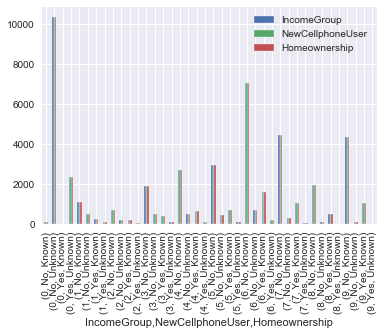

In [110]:
plt.figure(figsize=(12,12))
df_grp = df.groupby(['IncomeGroup','NewCellphoneUser', 'Homeownership'])['IncomeGroup','NewCellphoneUser', 'Homeownership'].count()
df_grp.plot.bar()


The barplot above shows how many values are there for eaach category. Here we find, (IncomeGroup-6, Old Cell Phone Users and Unknown HomeOwnerShip) and (IncomeGroup-0, Old Cell Phone Users and Unknown HomeOwnerShip) have the largest number of values

In [164]:
def boxes(x,y,h,r=45):
    fig, ax = plt.subplots(figsize=(24,15))
    box = sns.boxplot(x=x,y=y, hue=h, data=df)
    box.set_xticklabels(box.get_xticklabels(), rotation=r, fontsize=20)
    fig.subplots_adjust(bottom=0.2)
    plt.ylabel(y,fontsize=20)
    plt.xlabel(x,fontsize=20)
    plt.legend(loc=2,prop={'size': 24})
    plt.tight_layout()

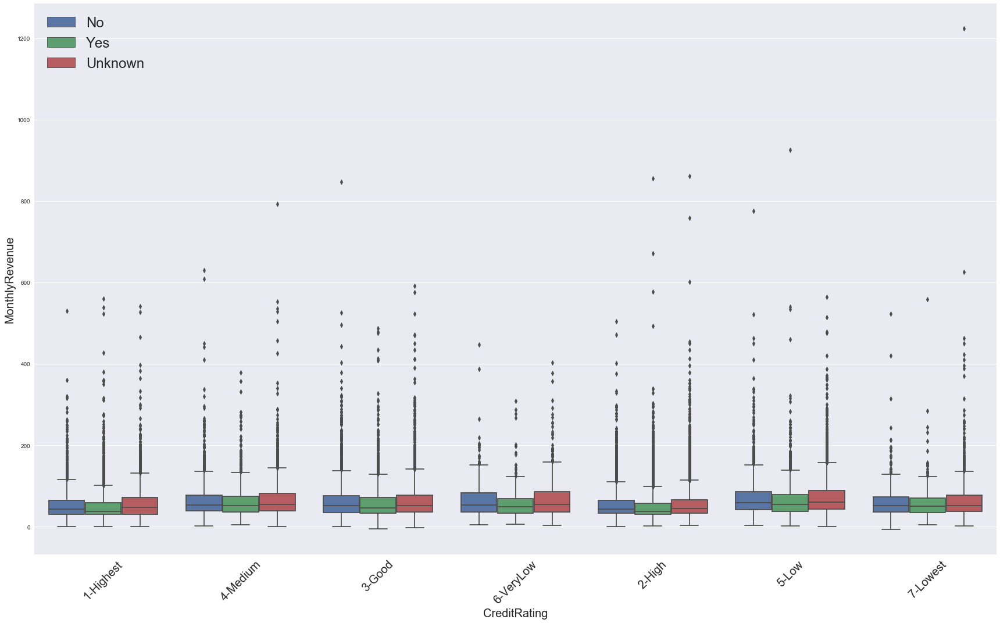

In [165]:
boxes("CreditRating","MonthlyRevenue","MaritalStatus")

In [147]:
df['RespondsToMailOffers'].unique()

array(['Yes', 'No'], dtype=object)

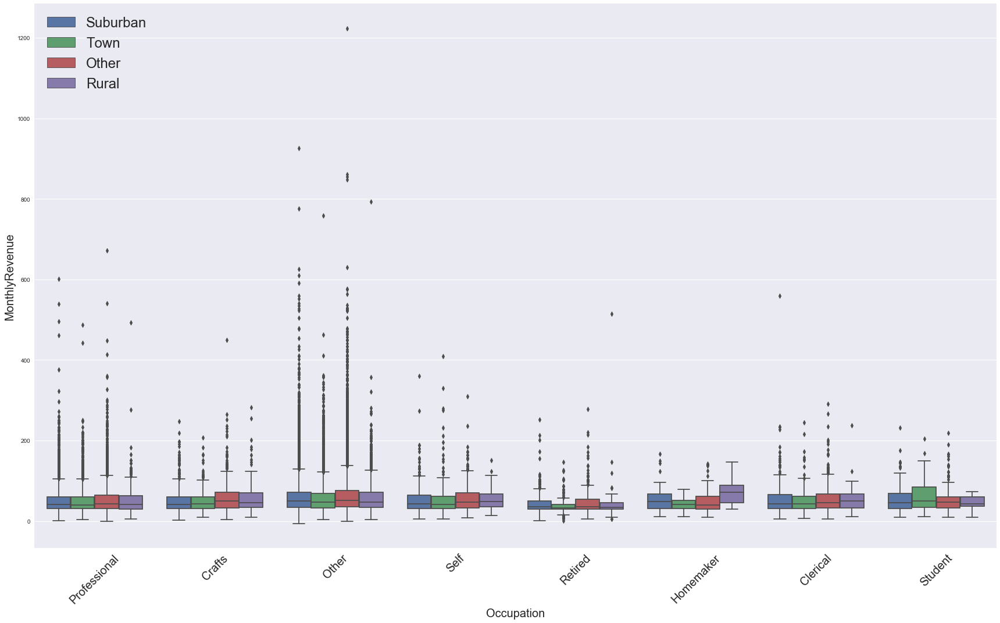

In [166]:
boxes("Occupation", "MonthlyRevenue","PrizmCode")

The plot above shows that the highest MonthlyRevenue are from people with Other Professions, Proefessionals, Crafts, and Self Employed Persons. Here people living in Other and Town are proportionally higher except for Retired and Homemakers.

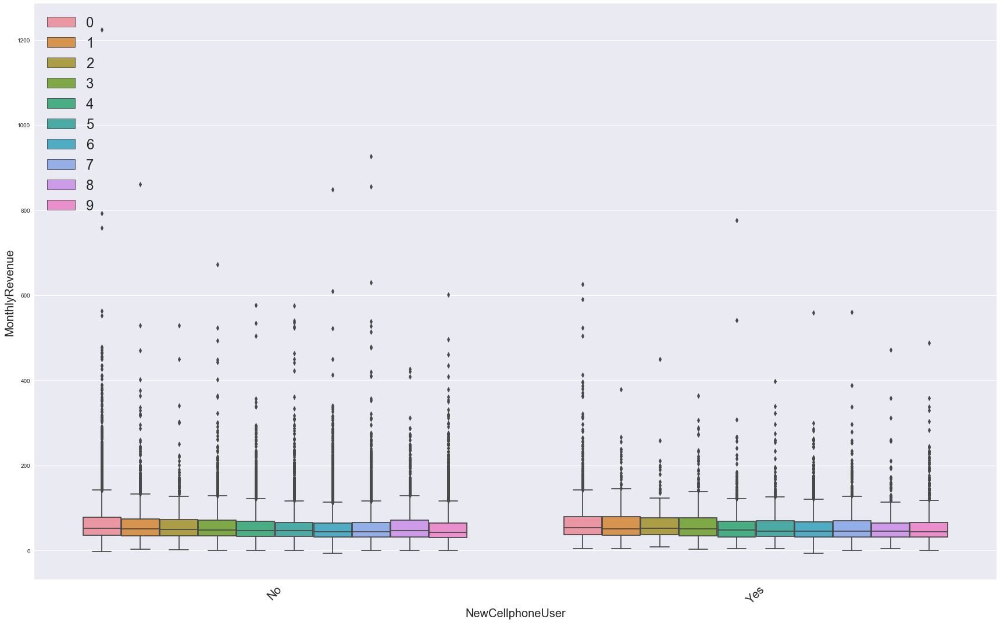

In [167]:
boxes("NewCellphoneUser", "MonthlyRevenue","IncomeGroup")

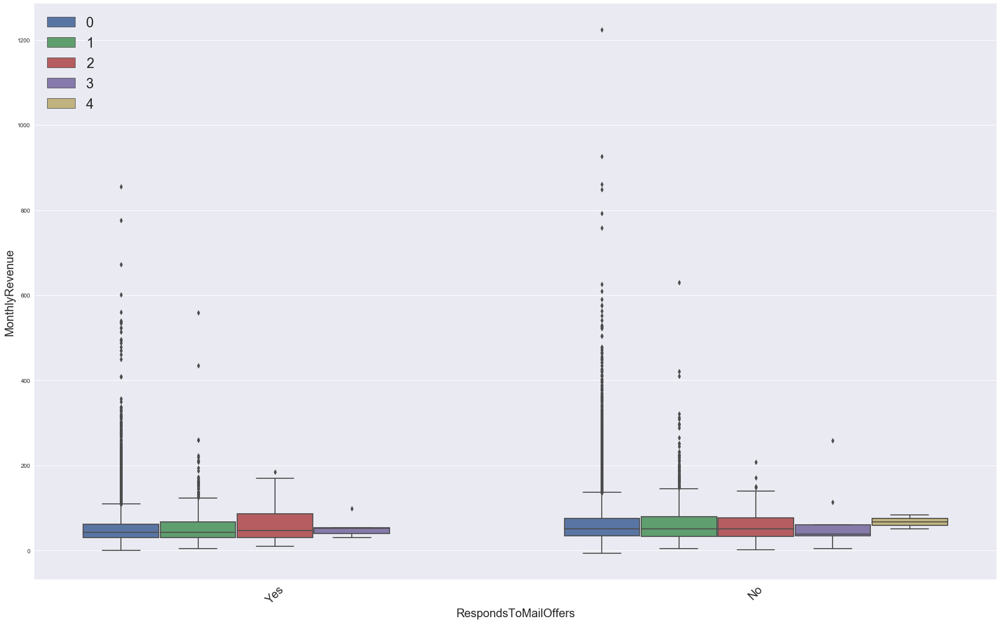

In [168]:
boxes("RespondsToMailOffers", "MonthlyRevenue",  "RetentionCalls")

The boxplot above indicates that generally there is less number of retention calls for lower MonthlyRevenue.

In [173]:
df['RetentionCalls'].unique()

array([1, 0, 3, 2, 4])

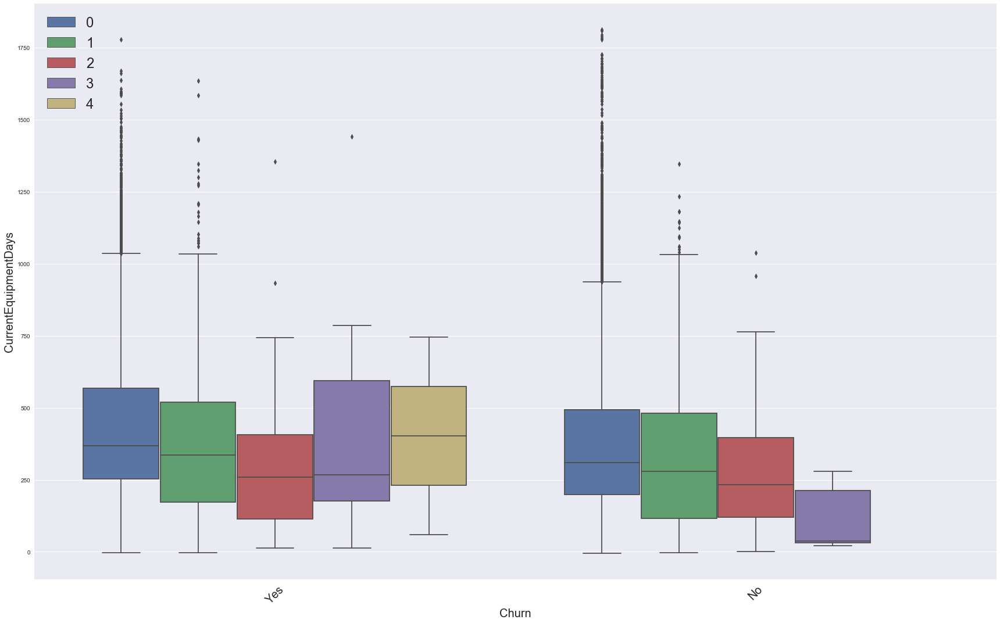

In [172]:
boxes("Churn", "CurrentEquipmentDays",  "RetentionCalls")

Customers who "Churn" have received higher number of "RetentionCalls"

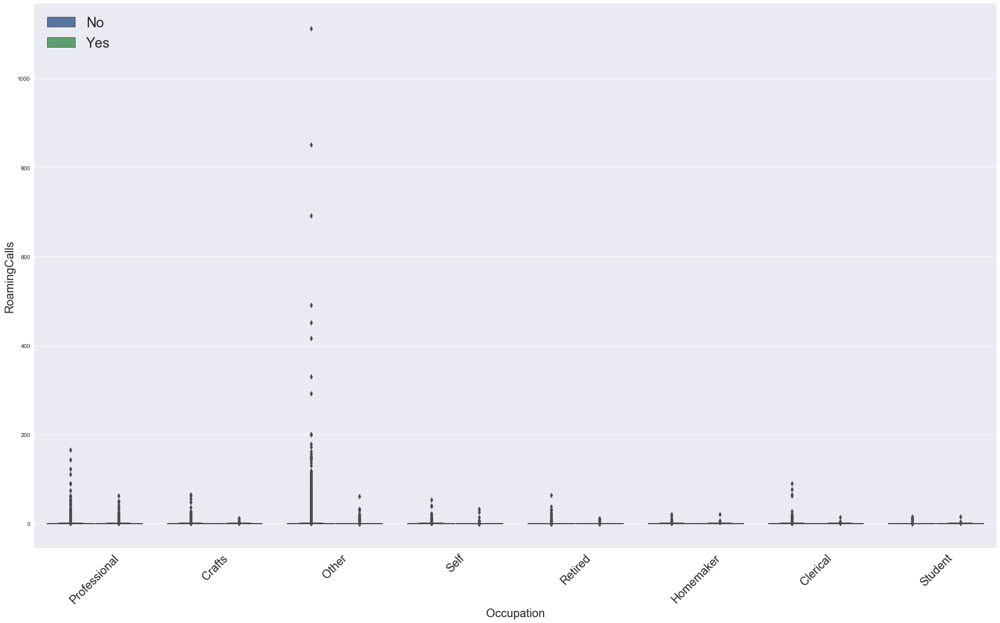

In [182]:
boxes("Occupation", "RoamingCalls",  "NonUSTravel")

# K-Meeans Clustering

#### Selecting columns for clusterisation with K-means 'CurrentEquipmentDays', 'CreditRating', 'MonthsInService', 'IncomeGroup', 'Occupation','MonthlyRevenue'

In [10]:
selected_cols = ['CurrentEquipmentDays', 'CreditRating', 'MonthsInService', 'IncomeGroup', 'Occupation','MonthlyRevenue']
cluster_data = df.loc[:,selected_cols]

In [11]:
cluster_data["CreditRating"] = cluster_data["CreditRating"].astype('category').cat.codes
cluster_data["MonthsInService"] = cluster_data["MonthsInService"].astype('category').cat.codes
cluster_data["IncomeGroup"] = cluster_data["IncomeGroup"].astype('category').cat.codes
cluster_data["Occupation"] = cluster_data["Occupation"].astype('category').cat.codes

def distributions(df):
    fig, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6,1, figsize=(16,12))
    sns.distplot(cluster_data["CurrentEquipmentDays"], ax=ax1)
    sns.distplot(cluster_data["CreditRating"], ax=ax2)
    sns.distplot(cluster_data["MonthsInService"], ax=ax3)
    sns.distplot(cluster_data["IncomeGroup"], ax=ax4)
    sns.distplot(cluster_data["Occupation"], ax=ax5)
    sns.distplot(cluster_data["MonthlyRevenue"], ax=ax6)

    plt.tight_layout()

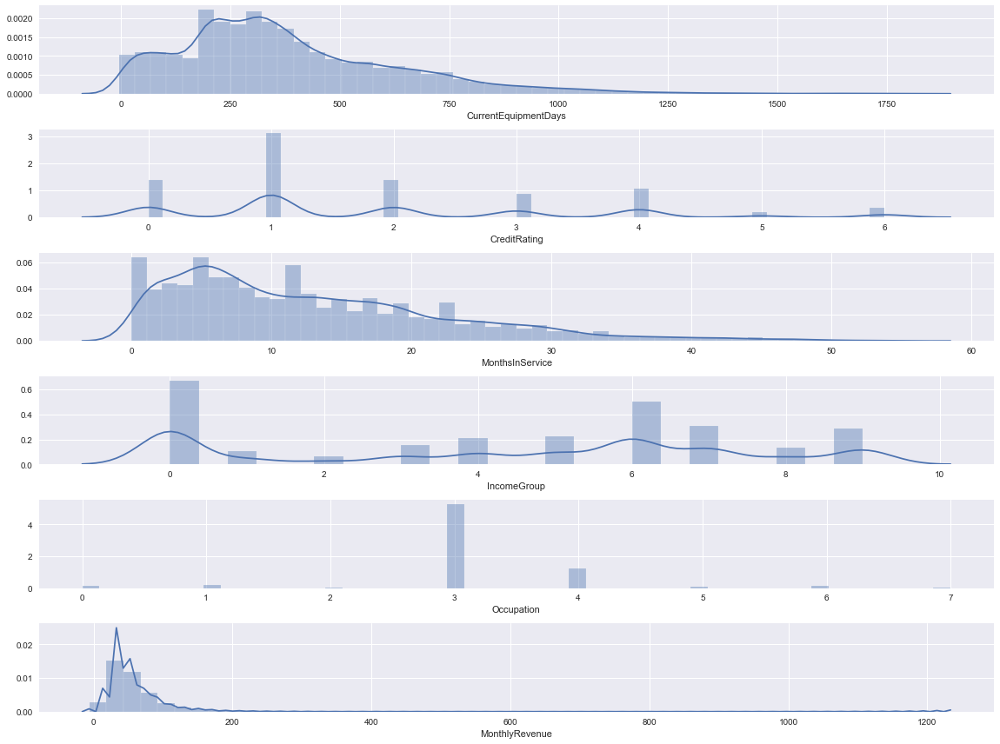

In [24]:
distributions(cluster_data)

We can see that distributions are right-skewed. To obtain better results we should remove the skewness by logarithmic transformation. After that let's see how they look like.

In [12]:
cluster_data = cluster_data.fillna(0)
cluster_data


,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue
0,361.0,0,55,4,4,24.00
1,1504.0,3,52,5,4,16.99
2,1812.0,2,54,6,1,38.00
3,458.0,3,53,6,3,82.28
4,852.0,0,47,9,4,17.14
...,...,...,...,...,...,...
51042,526.0,0,23,6,3,0.00
51043,464.0,2,23,9,3,95.17
51044,378.0,4,19,7,0,0.00
51045,433.0,4,25,9,3,0.00


In [13]:
scaler = StandardScaler()
cluster_scaled = scaler.fit_transform(cluster_data)

Using Elbow method determining the optimal number of clusters

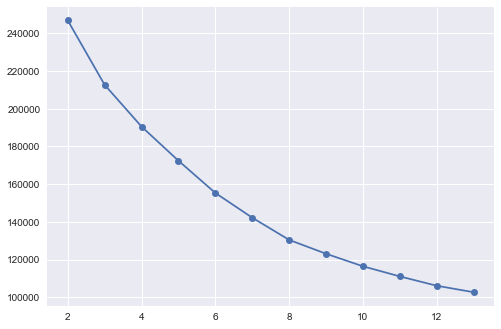

In [14]:
clusters_range = range(2,14)
inertias =[]

for c in clusters_range:
    kmeans = KMeans(n_clusters=c, random_state=0).fit(cluster_scaled)
    inertias.append(kmeans.inertia_)

plt.figure()
plt.plot(clusters_range,inertias, marker='o')

The plot above shows that inertia decreases with increasing number of clusters.

This method allows for assessment of cluster separations and fitting of each observation in its own cluster. The highest score the better. I will perform this analysis for various seeds as well.

Cluster no 2
Cluster no 3
Cluster no 4
Cluster no 5
Cluster no 6
Cluster no 7
Cluster no 8
Cluster no 9
Cluster no 10
Cluster no 11
Cluster no 12
Cluster no 13
Cluster no 14


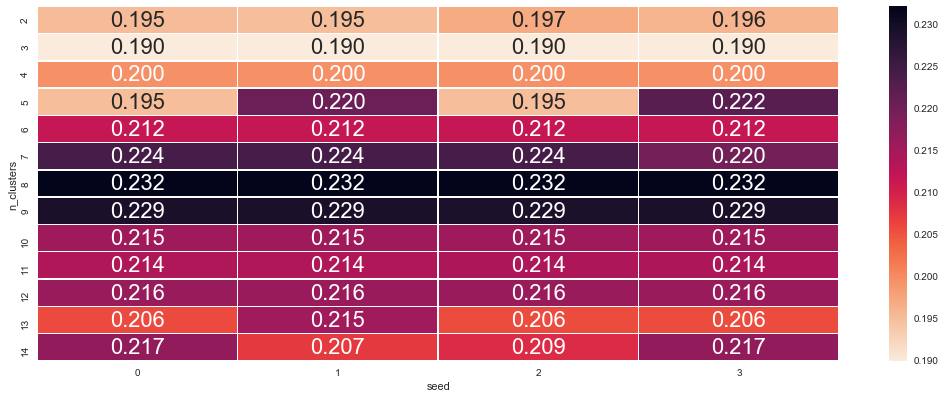

In [283]:
clusters_range = range(2,15)
random_range = range(0,4)
result_kmeans =[]
for c in clusters_range:
    print("Cluster no", c)
    for r in random_range:
        clusterer = KMeans(n_clusters=c, random_state=r)
        cluster_labels = clusterer.fit_predict(cluster_scaled)
        silhouette_avg = silhouette_score(cluster_scaled, cluster_labels)
        #print("For n_clusters =", c,  "\nThe average silhouette_score is :", silhouette_avg)
        result_kmeans.append([c,r,silhouette_avg])

result_kmeans = pd.DataFrame(result_kmeans, columns=["n_clusters","seed","silhouette_score"])
pivot_km = pd.pivot_table(result_kmeans, index="n_clusters", columns="seed",values="silhouette_score")

plt.figure(figsize=(15,6))
sns.heatmap(pivot_km, annot=True, linewidths=.5, fmt='.3f', cmap=sns.cm.rocket_r)
plt.tight_layout()

Finding the highest Silhouette_scores and their coressponding number of clusters.

In [284]:
max_sh = result_kmeans['silhouette_score'].max()
min_sh = result_kmeans['silhouette_score'].min()

max_sh_clusters = result_kmeans[result_kmeans['silhouette_score'] == max_sh]
min_sh_clusters = result_kmeans[result_kmeans['silhouette_score'] == min_sh]


print("max SH", max_sh, max_sh_clusters.iloc[0])
print("min SH", min_sh, min_sh_clusters.iloc[0])

max SH 0.23200153574008328 n_clusters          8.000000
seed                2.000000
silhouette_score    0.232002
Name: 26, dtype: float64
min SH 0.18991152303146855 n_clusters          3.000000
seed                1.000000
silhouette_score    0.189912
Name: 5, dtype: float64


The heatmap above shows silhouette scores for various combinations of random state and number of clusters. The highest scores are for 8 and 9 clusters and they are relatively insensitive to seed.

I will chose 8 clusters to get more insight into data.

In [15]:
kmeans_sel = KMeans(n_clusters=8, random_state=1).fit(cluster_scaled)
labels = pd.DataFrame(kmeans_sel.labels_)
clustered_data = cluster_data.assign(Cluster=labels)
clustered_data

,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue,Cluster
0,361.0,0,55,4,4,24.00,4
1,1504.0,3,52,5,4,16.99,6
2,1812.0,2,54,6,1,38.00,6
3,458.0,3,53,6,3,82.28,4
4,852.0,0,47,9,4,17.14,6
...,...,...,...,...,...,...,...
51042,526.0,0,23,6,3,0.00,6
51043,464.0,2,23,9,3,95.17,4
51044,378.0,4,19,7,0,0.00,5
51045,433.0,4,25,9,3,0.00,4


#### Plotting Customer , Device Properties corresponding to 8 different Clusters

In [16]:
def scatters(data, h=None, pal=None):
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5,1, figsize=(18,15))
    sns.scatterplot(x="CurrentEquipmentDays",y="Occupation", hue=h, palette=pal, data=data, ax=ax1)
    sns.scatterplot(x="CreditRating",y="Occupation", hue=h, palette=pal, data=data, ax=ax2)
    sns.scatterplot(x="MonthsInService",y="Occupation", hue=h, palette=pal, data=data, ax=ax3)
    sns.scatterplot(x="IncomeGroup",y="Occupation", hue=h, palette=pal, data=data, ax=ax4)
    sns.scatterplot(x="MonthlyRevenue",y="Occupation", hue=h, palette=pal, data=data, ax=ax5)

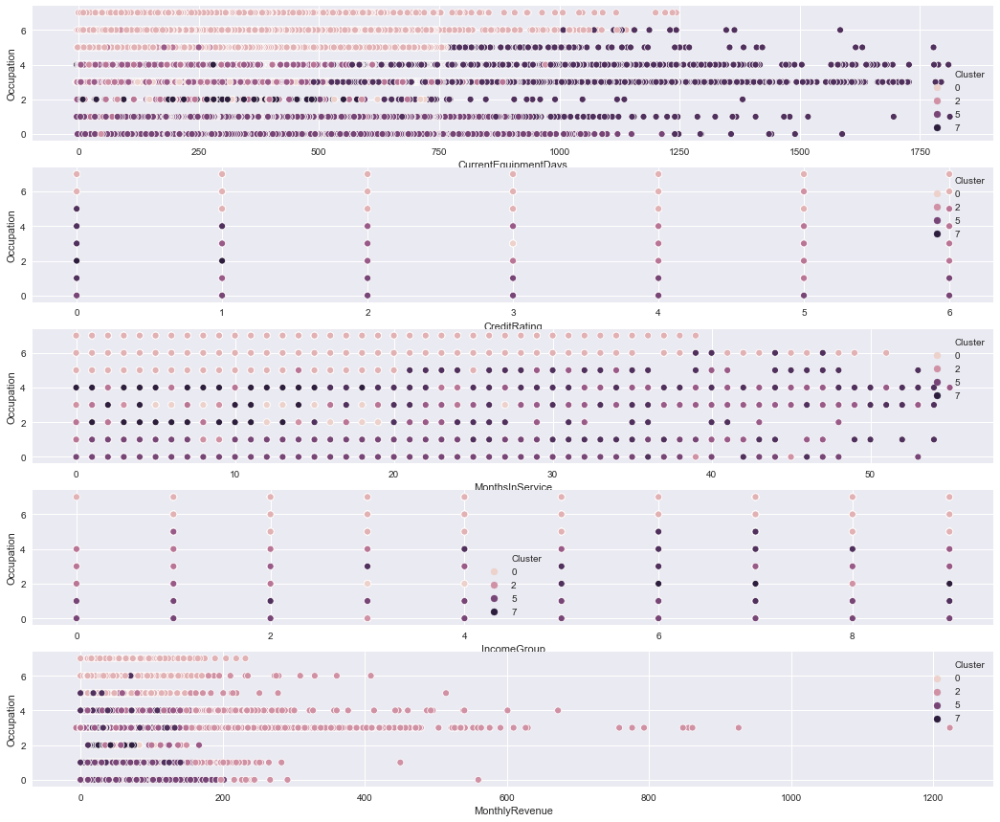

In [17]:
scatters(clustered_data, 'Cluster')

In [18]:
grouped_km = clustered_data.groupby(['Cluster']).mean().round(1)
grouped_km

,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue
Cluster,,,,,,
0,323.3,1.5,8.3,0.5,3.0,52.6
1,387.3,1.4,13.1,5.6,5.9,49.8
2,239.1,2.3,11.7,3.8,3.1,205.1
3,276.1,4.4,8.9,2.5,3.1,61.9
4,241.0,1.0,28.7,5.2,3.2,63.7
5,374.8,1.8,12.2,5.2,0.6,51.6
6,819.1,1.0,23.1,5.7,3.3,41.7
7,317.8,1.4,7.6,6.7,3.3,48.5


Cluster 0 – lower income group, lower credit rating, high equipment days, low monthly revenue, medium months in service

Cluster 1 – mid income group, lower credit rating, high equipment days, low monthly revenue, medium months in service

Cluster 2 - low to mid income group, low credit rating, medium equipment days, high monthly revenue, high months in service

Cluster 3 - low to mid income group, high credit rating, medium equipment days, medium monthly revenue, medium months in service


Cluster 4 - mid income group, low credit rating, medium equipment days, medium monthly revenue, high months in service


Cluster 5 - mid income group, low credit rating, high equipment days, medium monthly revenue, high months in service


Cluster 6 - mid income group, low credit rating, very high equipment days, medium monthly revenue, high months in service


Cluster 7 - high income group, low credit rating, very high equipment days, medium monthly revenue, medium months in service

# Clustering with Affinity Propagation

Taking a lot of time in laptop , need to run on cloud

In [ ]:
# preferences = np.arange(-30,-190,-10)
# print(preferences)
# clusters = []

# for p in preferences:
#     af = AffinityPropagation(preference=p, damping=0.6, max_iter=400, verbose=False).fit(cluster_scaled)
#     print(p)
#     labels_af = pd.DataFrame(af.labels_)
#     clusters.append(len(af.cluster_centers_indices_))

# plt.figure(figsize=(10,7))
# plt.xlabel("Preference")
# plt.ylabel("Number of clusters")
# plt.plot(preferences,clusters, marker='o')

[ -30  -40  -50  -60  -70  -80  -90 -100 -110 -120 -130 -140 -150 -160
 -170 -180]


In [ ]:
# af = AffinityPropagation(preference=-140, damping=0.6, verbose=False).fit(cluster_scaled)
# labels_af = pd.DataFrame(af.labels_)
# n_clusters_ = len(af.cluster_centers_indices_)

# clustered_data_af = cluster_data.assign(Cluster=labels_af)
# scatters(clustered_data_af,'Cluster')

# grouped_af = clustered_data_af.groupby(['Cluster']).mean().round(1)


In [ ]:
# grouped_af = clustered_data_af.groupby(['Cluster']).mean().round(1)
# grouped_af

# Modeling with dabl

Chcek how different classifiers of dbl works

In [10]:
ec = dabl.SimpleClassifier(random_state=0).fit(df, target_col="Churn") 

Running DummyClassifier(strategy='prior')
accuracy: 0.712 average_precision: 0.288 roc_auc: 0.500 recall_macro: 0.500 f1_macro: 0.416
=== new best DummyClassifier(strategy='prior') (using recall_macro):
accuracy: 0.712 average_precision: 0.288 roc_auc: 0.500 recall_macro: 0.500 f1_macro: 0.416

Running GaussianNB()
accuracy: 0.663 average_precision: 0.356 roc_auc: 0.601 recall_macro: 0.516 f1_macro: 0.440
=== new best GaussianNB() (using recall_macro):
accuracy: 0.663 average_precision: 0.356 roc_auc: 0.601 recall_macro: 0.516 f1_macro: 0.440

Running MultinomialNB()
accuracy: 0.710 average_precision: 0.382 roc_auc: 0.620 recall_macro: 0.513 f1_macro: 0.458
Running DecisionTreeClassifier(class_weight='balanced', max_depth=1)
accuracy: 0.543 average_precision: 0.330 roc_auc: 0.584 recall_macro: 0.584 f1_macro: 0.533
=== new best DecisionTreeClassifier(class_weight='balanced', max_depth=1) (using recall_macro):
accuracy: 0.543 average_precision: 0.330 roc_auc: 0.584 recall_macro: 0.584 f

In [18]:
df1= dabl.clean(df)

The SimpleClassifier first tries several baseline and instantaneous models, potentially on subsampled data, to get an idea of what a low baseline should be.

# KMeans Clustering with PCA 

In [24]:
df.columns

Index(['CustomerID', 'Churn', 'MonthlyRevenue', 'MonthlyMinutes',
       'TotalRecurringCharge', 'DirectorAssistedCalls', 'OverageMinutes',
       'RoamingCalls', 'PercChangeMinutes', 'PercChangeRevenues',
       'DroppedCalls', 'BlockedCalls', 'UnansweredCalls', 'CustomerCareCalls',
       'ThreewayCalls', 'ReceivedCalls', 'OutboundCalls', 'InboundCalls',
       'PeakCallsInOut', 'OffPeakCallsInOut', 'DroppedBlockedCalls',
       'CallForwardingCalls', 'CallWaitingCalls', 'MonthsInService',
       'UniqueSubs', 'ActiveSubs', 'ServiceArea', 'Handsets', 'HandsetModels',
       'CurrentEquipmentDays', 'AgeHH1', 'AgeHH2', 'ChildrenInHH',
       'HandsetRefurbished', 'HandsetWebCapable', 'TruckOwner', 'RVOwner',
       'Homeownership', 'BuysViaMailOrder', 'RespondsToMailOffers',
       'OptOutMailings', 'NonUSTravel', 'OwnsComputer', 'HasCreditCard',
       'RetentionCalls', 'RetentionOffersAccepted', 'NewCellphoneUser',
       'NotNewCellphoneUser', 'ReferralsMadeBySubscriber', 'IncomeGro

In [25]:
selected_pca_cols = ['MonthlyRevenue', 'MonthlyMinutes',
       'TotalRecurringCharge', 'DirectorAssistedCalls', 'OverageMinutes',
       'RoamingCalls', 'PercChangeMinutes', 'PercChangeRevenues',
       'DroppedCalls', 'BlockedCalls', 'UnansweredCalls', 'CustomerCareCalls',
       'ThreewayCalls', 'ReceivedCalls', 'OutboundCalls', 'InboundCalls',
       'PeakCallsInOut', 'OffPeakCallsInOut', 'DroppedBlockedCalls',
       'CallForwardingCalls', 'CallWaitingCalls', 'MonthsInService',
       'UniqueSubs', 'ActiveSubs', 'ServiceArea', 'Handsets', 'HandsetModels',
       'CurrentEquipmentDays', 'AgeHH1', 'AgeHH2', 'ChildrenInHH',
       'HandsetRefurbished', 'HandsetWebCapable', 'TruckOwner', 'RVOwner',
       'Homeownership', 'BuysViaMailOrder', 'RespondsToMailOffers',
       'OptOutMailings', 'NonUSTravel', 'OwnsComputer', 'HasCreditCard',
       'RetentionCalls', 'RetentionOffersAccepted', 'NewCellphoneUser',
       'NotNewCellphoneUser', 'ReferralsMadeBySubscriber', 'IncomeGroup',
       'OwnsMotorcycle', 'AdjustmentsToCreditRating', 'HandsetPrice',
       'MadeCallToRetentionTeam', 'CreditRating', 'PrizmCode', 'Occupation',
       'MaritalStatus', 'Churn']


cluster_pca_data = df.loc[:,selected_pca_cols]

In [26]:
print("Encoding each categorical column:")
for col in cluster_pca_data.select_dtypes(include=[object]):
    cluster_pca_data[col] = cluster_pca_data[col].astype('category').cat.codes

Encoding each categorical column:


In [27]:
cluster_pca_data = cluster_pca_data.fillna(0)
X =  cluster_pca_data[cluster_pca_data.columns[0:len(cluster_pca_data.columns) -1]]
print(X.shape)
y = cluster_pca_data['Churn']

scaler = StandardScaler()
cluster_pca_scaled = scaler.fit_transform(cluster_pca_data)

(51047, 56)


# 2 Principal Components

In [28]:
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(cluster_pca_scaled)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

finalDf = pd.concat([principalDf, y], axis = 1)

In [107]:
np.unique(y)

array([0, 1], dtype=int8)

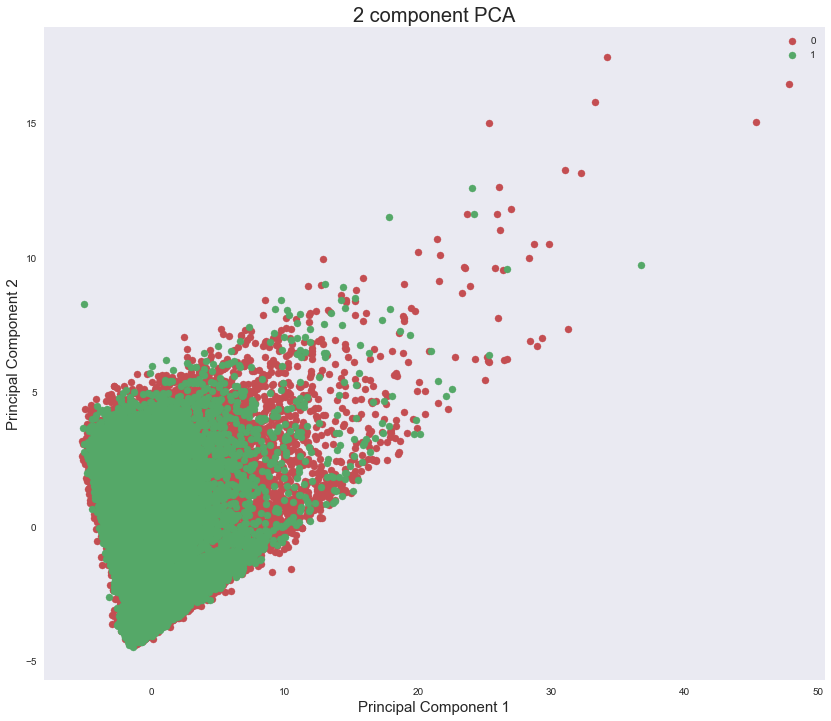

In [91]:
fig = plt.figure(figsize = (14,12))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [0, 1]
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['Churn'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

In [92]:
pca.explained_variance_ratio_

array([0.16311142, 0.09322639])

# KMeans Clustering with PCA

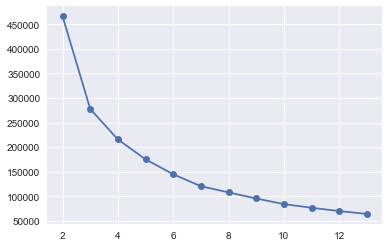

In [58]:
clusters_range = range(2,14)
inertias =[]

for c in clusters_range:
    kmeans = KMeans(n_clusters=c, random_state=0).fit(principalDf)
    inertias.append(kmeans.inertia_)

plt.figure()
plt.plot(clusters_range,inertias, marker='o')

Cluster No 2
Cluster No 3
Cluster No 4
Cluster No 5
Cluster No 6
Cluster No 7
Cluster No 8
Cluster No 9
Cluster No 10
Cluster No 11
Cluster No 12
Cluster No 13
Cluster No 14


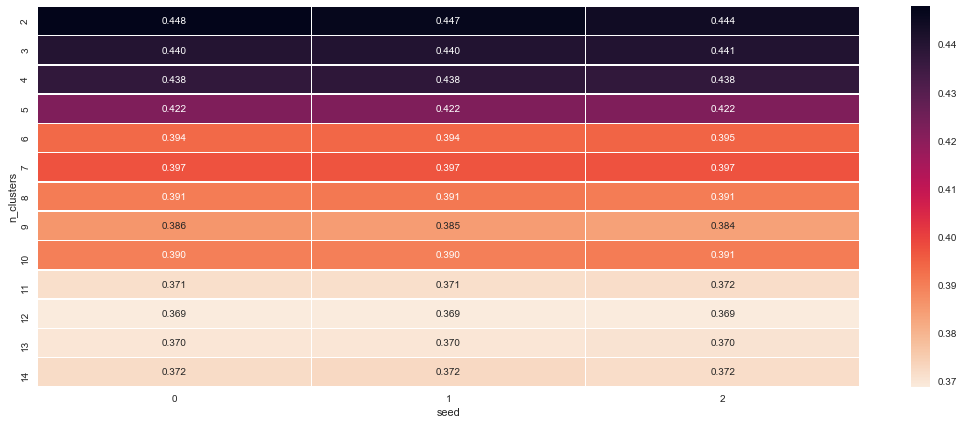

In [59]:
clusters_range = range(2,15)
random_range = range(0,3)
result_kmeans =[]
for c in clusters_range:
    print("Cluster No", c)
    for r in random_range:
        clusterer = KMeans(n_clusters=c, random_state=r)    
        cluster_labels = clusterer.fit_predict(principalDf)
        silhouette_avg = silhouette_score(principalDf, cluster_labels)
        #print("For n_clusters =", c,  "\nThe average silhouette_score is :", silhouette_avg)
        result_kmeans.append([c,r,silhouette_avg])

result_kmeans = pd.DataFrame(result_kmeans, columns=["n_clusters","seed","silhouette_score"])
pivot_km = pd.pivot_table(result_kmeans, index="n_clusters", columns="seed",values="silhouette_score")

plt.figure(figsize=(15,6))
sns.heatmap(pivot_km, annot=True, linewidths=.5, fmt='.3f', cmap=sns.cm.rocket_r)
plt.tight_layout()

#### Finding the Min and Max Silhouette_scores and their corressponding clusters

In [ ]:
max_sh = result_kmeans['silhouette_score'].max()
min_sh = result_kmeans['silhouette_score'].min()

max_sh_clusters = result_kmeans[result_kmeans['silhouette_score'] == max_sh]
min_sh_clusters = result_kmeans[result_kmeans['silhouette_score'] == min_sh]


print("max SH", max_sh, max_sh_clusters.iloc[0])
print("min SH", min_sh, min_sh_clusters.iloc[0])

Here 2,3, 4 clusters have the highest silhouette_score. I go with 3 clusters

In [41]:
kmeans_sel = KMeans(n_clusters=3, random_state=1).fit(principalDf)
labels = pd.DataFrame(kmeans_sel.labels_)
finalDf_labels = pd.concat([finalDf, labels], axis = 1)
finalDf_labels

,principal component 1,principal component 2,Churn,0
0,-2.205556,1.324516,1,1
1,-4.165349,2.040727,1,1
2,-3.310273,-0.822185,0,1
3,11.264954,5.224074,0,2
4,-3.361281,2.809157,1,1
...,...,...,...,...
51042,-2.121303,2.122081,1,1
51043,3.953560,4.352964,0,2
51044,16.655109,4.606602,1,2
51045,-1.873863,-2.318888,0,0


In [42]:
cluster_data

,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue
0,361.0,0,55,4,4,24.00
1,1504.0,3,52,5,4,16.99
2,1812.0,2,54,6,1,38.00
3,458.0,3,53,6,3,82.28
4,852.0,0,47,9,4,17.14
...,...,...,...,...,...,...
51042,526.0,0,23,6,3,0.00
51043,464.0,2,23,9,3,95.17
51044,378.0,4,19,7,0,0.00
51045,433.0,4,25,9,3,0.00


In [45]:
clustered_data = cluster_data.assign(Cluster=labels)
clustered_data

,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue,Cluster
0,361.0,0,55,4,4,24.00,1
1,1504.0,3,52,5,4,16.99,1
2,1812.0,2,54,6,1,38.00,1
3,458.0,3,53,6,3,82.28,2
4,852.0,0,47,9,4,17.14,1
...,...,...,...,...,...,...,...
51042,526.0,0,23,6,3,0.00,1
51043,464.0,2,23,9,3,95.17,2
51044,378.0,4,19,7,0,0.00,2
51045,433.0,4,25,9,3,0.00,0


In [46]:
grouped_km = clustered_data.groupby(['Cluster']).mean().round(1)
grouped_km

,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue
Cluster,,,,,,
0,358.5,2.3,11.0,2.3,3.0,53.4
1,441.6,1.3,14.2,6.2,3.3,45.9
2,217.5,2.6,12.9,3.6,3.1,123.8


In [102]:
print(df.shape)
finalDf_labels = finalDf_labels.fillna(0)

(51047, 58)


Cluster 0 – lower income group, lower credit rating, high equipment days, low monthly revenue, medium months in service

Cluster 1 – high income group, lower credit rating, high equipment days, low monthly revenue, high months in service

Cluster 2 - low to mid income group, low credit rating, medium equipment days, high monthly revenue, medium months in service


## Plotting 2 component PCA

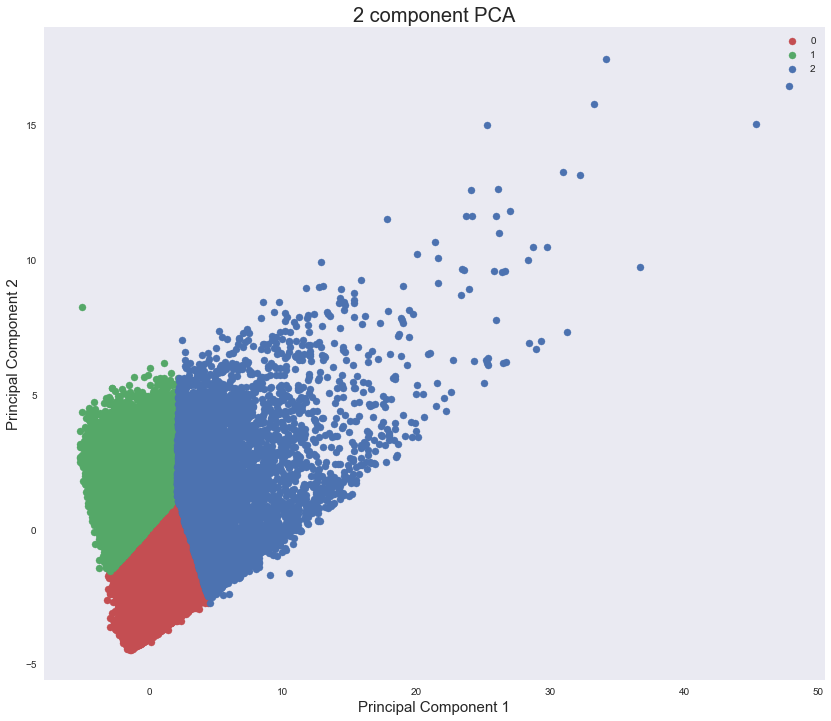

In [121]:
fig = plt.figure(figsize = (14,12))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [0, 1, 2]
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf_labels['cluster_labels'] == target
    ax.scatter(finalDf_labels.loc[indicesToKeep, 'principal component 1']
               , finalDf_labels.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

# Plotting Customer Properties based on Cluster Labels

In [20]:
def segment_customers(data, h, pal=None):
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5,1, figsize=(18,12))
    for item in ([ax1.title, ax1.xaxis.label, ax1.yaxis.label] +
              ax1.get_xticklabels() + ax1.get_yticklabels()):
        item.set_fontsize(14)
        
    for item in ([ax2.title, ax2.xaxis.label, ax2.yaxis.label] +
              ax2.get_xticklabels() + ax2.get_yticklabels()):
        item.set_fontsize(14)
        
    for item in ([ax3.title, ax3.xaxis.label, ax3.yaxis.label] +
              ax3.get_xticklabels() + ax3.get_yticklabels()):
        item.set_fontsize(14)
        
        
    for item in ([ax4.title, ax4.xaxis.label, ax4.yaxis.label] +
              ax4.get_xticklabels() + ax4.get_yticklabels()):
        item.set_fontsize(14)
        
    for item in ([ax5.title, ax5.xaxis.label, ax5.yaxis.label] +
              ax5.get_xticklabels() + ax5.get_yticklabels()):
        item.set_fontsize(14)
        
    ax1.legend(loc=2,prop={'size': 14})
    ax2.legend(loc=2,prop={'size': 14})
    ax3.legend(loc=2,prop={'size': 14})
    ax4.legend(loc=2,prop={'size': 14})
    ax5.legend(loc=2,prop={'size': 14})
    
    sns.scatterplot(x="CurrentEquipmentDays",y="Occupation", hue=h, palette=pal, data=data, ax=ax1)
    sns.scatterplot(x="CreditRating",y="Occupation", hue=h, palette=pal, data=data, ax=ax2)
    sns.scatterplot(x="MonthsInService",y="Occupation", hue=h, palette=pal, data=data, ax=ax3)
    sns.scatterplot(x="IncomeGroup",y="Occupation", hue=h, palette=pal, data=data, ax=ax4)
    sns.scatterplot(x="MonthlyRevenue",y="Occupation", hue=h, palette=pal, data=data, ax=ax5)

In [158]:
print(df_io['cluster_labels'].unique())

[1 2 0]


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


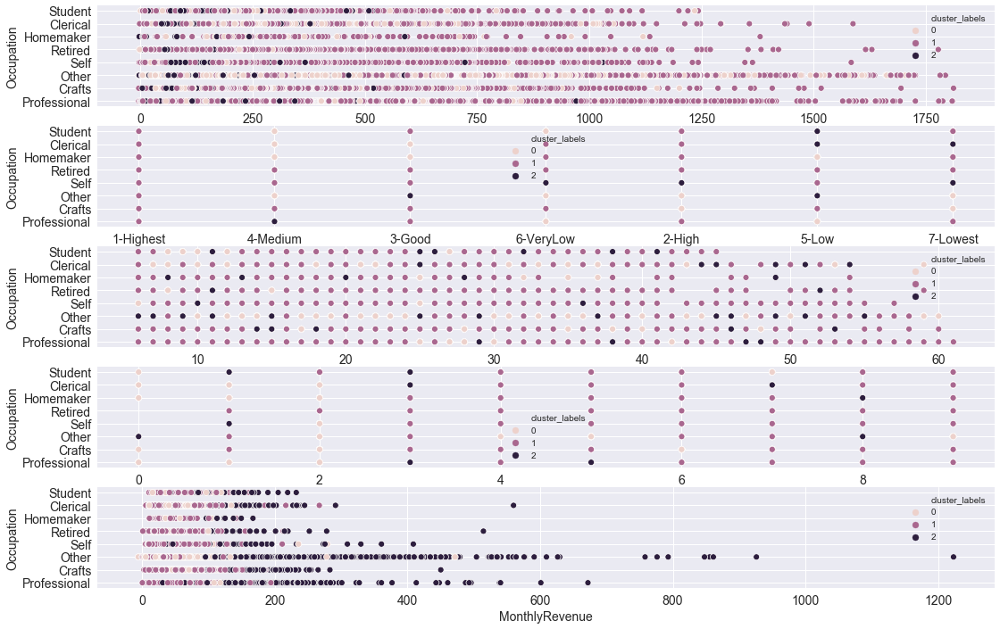

In [159]:
segment_customers(df_io, df_io['cluster_labels'])

In [160]:
principalDf[principalDf[labels==0]].iloc[:,0]


0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
51042   NaN
51043   NaN
51044   NaN
51045   NaN
51046   NaN
Name: principal component 1, Length: 51047, dtype: float64

In [161]:
print(np.shape(kmeans_sel.cluster_centers_[:, 1]), np.shape(kmeans_sel.cluster_centers_[:, 0]))

(3,) (3,)


# PCA with 3 components

In [30]:
print(np.shape(cluster_pca_scaled))
pca_n = PCA(n_components=3)
principalComponents_n = pca_n.fit_transform(cluster_pca_scaled)

principalComponents_n
principalDf_n = pd.DataFrame(data = principalComponents_n, columns = ['principal component 1', 'principal component 2', 'principal component 3'])

finalDf_n = pd.concat([principalDf_n, y], axis = 1)
finalDf_n

(51047, 57)


,principal component 1,principal component 2,principal component 3,Churn
0,-2.205556,1.324468,5.927293,1
1,-4.165349,2.040679,0.782390,1
2,-3.310273,-0.822147,0.172222,0
3,11.264953,5.223972,2.330177,0
4,-3.361281,2.809217,3.305833,1
...,...,...,...,...
51042,-2.121303,2.122043,0.690256,1
51043,3.953560,4.352990,-0.778136,0
51044,16.655109,4.606585,-2.665618,1
51045,-1.873863,-2.318882,0.928127,0


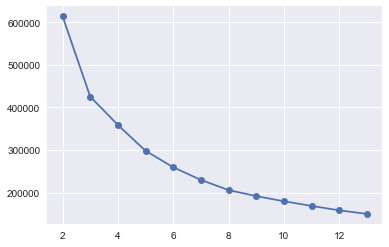

In [168]:
clusters_range = range(2,14)
inertias =[]

for c in clusters_range:
    kmeans = KMeans(n_clusters=c, random_state=0).fit(principalDf_n)
    inertias.append(kmeans.inertia_)

plt.figure()
plt.plot(clusters_range,inertias, marker='o')

In [170]:
principalDf_n

,principal component 1,principal component 2,principal component 3
0,-2.205556,1.324503,5.926592
1,-4.165349,2.040675,0.781603
2,-3.310273,-0.822179,0.172408
3,11.264954,5.224044,2.328781
4,-3.361282,2.809188,3.304594
...,...,...,...
51042,-2.121303,2.122035,0.690491
51043,3.953560,4.352968,-0.779290
51044,16.655109,4.606622,-2.667086
51045,-1.873863,-2.318881,0.927537


Cluster No 2
Cluster No 3
Cluster No 4
Cluster No 5
Cluster No 6
Cluster No 7
Cluster No 8
Cluster No 9
Cluster No 10
Cluster No 11
Cluster No 12
Cluster No 13
Cluster No 14


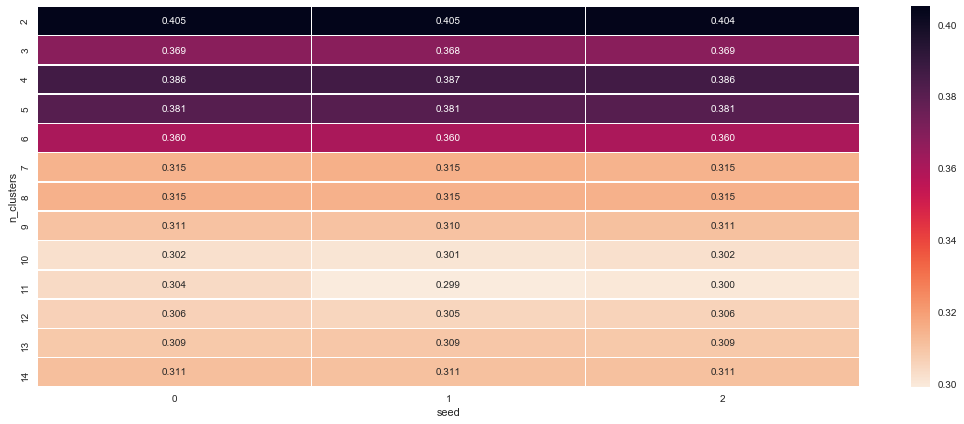

In [171]:
clusters_range = range(2,15)
random_range = range(0,3)
result_kmeans =[]
for c in clusters_range:
    print("Cluster No", c)
    for r in random_range:
        clusterer = KMeans(n_clusters=c, random_state=r)    
        cluster_labels = clusterer.fit_predict(principalDf_n)
        silhouette_avg = silhouette_score(principalDf_n, cluster_labels)
        #print("For n_clusters =", c,  "\nThe average silhouette_score is :", silhouette_avg)
        result_kmeans.append([c,r,silhouette_avg])

result_kmeans = pd.DataFrame(result_kmeans, columns=["n_clusters","seed","silhouette_score"])
pivot_km = pd.pivot_table(result_kmeans, index="n_clusters", columns="seed",values="silhouette_score")

plt.figure(figsize=(15,6))
sns.heatmap(pivot_km, annot=True, linewidths=.5, fmt='.3f', cmap=sns.cm.rocket_r)
plt.tight_layout()

Here I select 4 clusters as it has the highest optimal SH Score

In [31]:
kmeans_sel = KMeans(n_clusters=4, random_state=1).fit(principalDf_n)
cluster_labels = pd.DataFrame(kmeans_sel.labels_)
finalDf_n_labels = pd.concat([finalDf_n, labels], axis = 1)
finalDf_n_labels

,principal component 1,principal component 2,principal component 3,Churn,0
0,-2.205556,1.324468,5.927293,1,1
1,-4.165349,2.040679,0.782390,1,1
2,-3.310273,-0.822147,0.172222,0,1
3,11.264953,5.223972,2.330177,0,2
4,-3.361281,2.809217,3.305833,1,1
...,...,...,...,...,...
51042,-2.121303,2.122043,0.690256,1,1
51043,3.953560,4.352990,-0.778136,0,2
51044,16.655109,4.606585,-2.665618,1,2
51045,-1.873863,-2.318882,0.928127,0,0


In [47]:
clustered_data = cluster_data.assign(Cluster=cluster_labels)
clustered_data

,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue,Cluster
0,361.0,0,55,4,4,24.00,2
1,1504.0,3,52,5,4,16.99,1
2,1812.0,2,54,6,1,38.00,1
3,458.0,3,53,6,3,82.28,3
4,852.0,0,47,9,4,17.14,1
...,...,...,...,...,...,...,...
51042,526.0,0,23,6,3,0.00,1
51043,464.0,2,23,9,3,95.17,3
51044,378.0,4,19,7,0,0.00,3
51045,433.0,4,25,9,3,0.00,0


In [48]:
grouped_km = clustered_data.groupby(['Cluster']).mean().round(1)
grouped_km

,CurrentEquipmentDays,CreditRating,MonthsInService,IncomeGroup,Occupation,MonthlyRevenue
Cluster,,,,,,
0,359.6,2.3,10.7,2.3,3.0,53.6
1,445.7,1.3,13.9,6.2,3.3,45.9
2,300.0,1.8,21.3,4.3,3.1,59.6
3,219.8,2.7,12.2,3.6,3.1,126.2


Cluster 0 – lower income group, lower credit rating, high equipment days, low monthly revenue, medium months in service

Cluster 1 – high income group, lower credit rating, high equipment days, low monthly revenue, medium months in service

Cluster 2 - medium income group, low credit rating, high equipment days, high monthly revenue, high months in service

Cluster 3 - low to mid income group, high credit rating, medium equipment days, high monthly revenue, medium months in service


In [32]:
finalDf_n_labels = finalDf_n_labels.rename(columns = {0: 'cluster_labels'},inplace = False)
finalDf_n_labels

,principal component 1,principal component 2,principal component 3,Churn,cluster_labels
0,-2.205556,1.324468,5.927293,1,1
1,-4.165349,2.040679,0.782390,1,1
2,-3.310273,-0.822147,0.172222,0,1
3,11.264953,5.223972,2.330177,0,2
4,-3.361281,2.809217,3.305833,1,1
...,...,...,...,...,...
51042,-2.121303,2.122043,0.690256,1,1
51043,3.953560,4.352990,-0.778136,0,2
51044,16.655109,4.606585,-2.665618,1,2
51045,-1.873863,-2.318882,0.928127,0,0


In [33]:
df_n_io = pd.concat([df, finalDf_n_labels], axis = 1)
df_n_io

,CustomerID,Churn,MonthlyRevenue,MonthlyMinutes,TotalRecurringCharge,DirectorAssistedCalls,OverageMinutes,RoamingCalls,PercChangeMinutes,PercChangeRevenues,...,MadeCallToRetentionTeam,CreditRating,PrizmCode,Occupation,MaritalStatus,principal component 1,principal component 2,principal component 3,Churn,cluster_labels
0,3000002,Yes,24.00,219.0,22.0,0.25,0.0,0.0,-157.0,-19.0,...,Yes,1-Highest,Suburban,Professional,No,-2.205556,1.324468,5.927293,1,1
1,3000010,Yes,16.99,10.0,17.0,0.00,0.0,0.0,-4.0,0.0,...,No,4-Medium,Suburban,Professional,Yes,-4.165349,2.040679,0.782390,1,1
2,3000014,No,38.00,8.0,38.0,0.00,0.0,0.0,-2.0,0.0,...,No,3-Good,Town,Crafts,Yes,-3.310273,-0.822147,0.172222,0,1
3,3000022,No,82.28,1312.0,75.0,1.24,0.0,0.0,157.0,8.1,...,No,4-Medium,Other,Other,No,11.264953,5.223972,2.330177,0,2
4,3000026,Yes,17.14,0.0,17.0,0.00,0.0,0.0,0.0,-0.2,...,No,1-Highest,Other,Professional,Yes,-3.361281,2.809217,3.305833,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51042,3399958,Yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,No,1-Highest,Suburban,Other,Yes,-2.121303,2.122043,0.690256,1,1
51043,3399974,No,95.17,1745.0,85.0,0.99,45.0,4.7,122.0,15.9,...,No,3-Good,Other,Other,No,3.953560,4.352990,-0.778136,0,2
51044,3399978,Yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,No,5-Low,Other,Clerical,No,16.655109,4.606585,-2.665618,1,2
51045,3399990,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,No,5-Low,Other,Other,No,-1.873863,-2.318882,0.928127,0,0


# Plotting 3 dimensinal PCA using Plotly

In [28]:
fig = px.scatter_3d(df_n_io, x='principal component 1', y='principal component 2', z='principal component 3', color=cluster_labels)
fig.show()

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


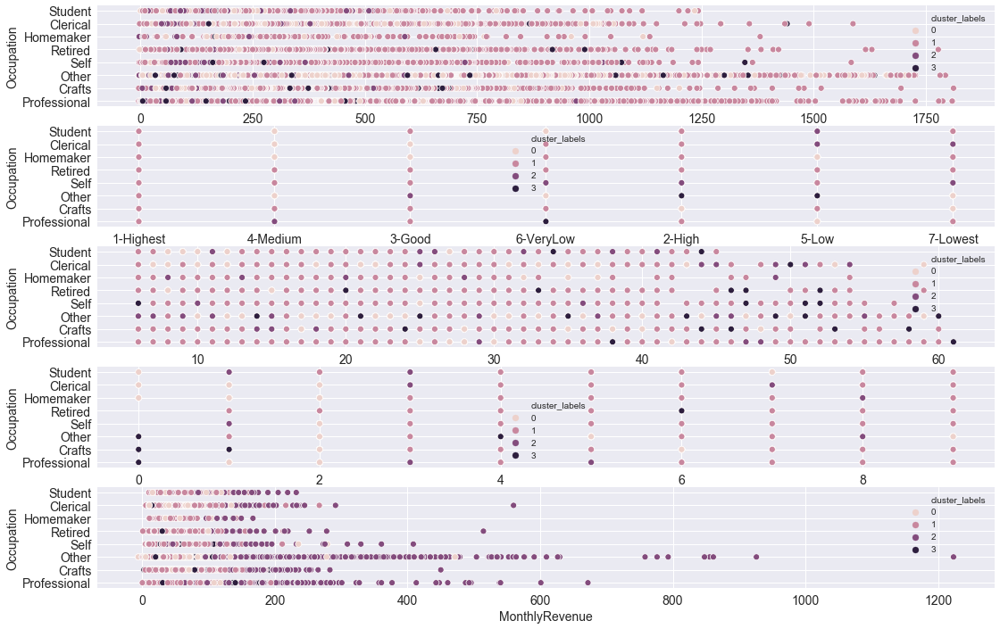

In [23]:
segment_customers(df_n_io, df_n_io['cluster_labels'])

In [29]:
fig = px.scatter_3d(df_n_io, x='CurrentEquipmentDays', y='CreditRating', z='MonthsInService', color=cluster_labels,  width=800, height=800)
fig.show()

In [30]:
fig = px.scatter_3d(df_n_io, x='IncomeGroup', y='MonthlyRevenue', z='MonthlyMinutes', color=cluster_labels)
fig.show()